# __BPIC17 Case Study:__ _DyLoPro: Profiling the Dynamics of Event Logs_

__NOTE__: This case study is performed with the __beta version__ of the  __DyLoPro__ library, which will soon be launched publically. 

The BPIC17 event log records cases of a loan application process of a Dutch financial institute, and consists of 31,413 cases and 1,198,366 events. 

This notebook contains the __extensive case study on the dynamics over time in the BPIC17 event log__. The BPIC17 event log can be downloaded [here](https://doi.org/10.4121/uuid:5f3067df-f10b-45da-b98b-86ae4c7a310b). 

This notebook consists of __7 sections__, with each section corresponding to a certain event log conceptualization, for which it contains the most interesting identified trends, patterns or changes over time. In each section, the visualizations are accompanied with markdown cells discussing these distinctive dynamics over time. 

0. [__General Remarks and Observations__](#0-general-observations-and-remarks)
1. [__Variants__](#1-variants)
1. [__Categorical Case Features__](#2-categorical-case-features): Interesting patterns and changes were observed for multiple categorical case features. 
1. [__Numerical Case Features__](#3-numeric-case-features)
1. [__Categorical Event Features__](#4-categorical-event-features): Interesting patterns and changes were observed for multiple categorical event features, including 'org:resource' _(resource perspective)_, 'Selected' & 'Accepted' _(both data perspective)_, and in 'concept:name', which contains the activity labels of the events _(control-flow perspective)_. 
1. [__Numerical Event Features__](#5-numerical-event-features)
1. __Appendix__: Additional materials. (Coming soon!)

More information regarding the event log and its features can be found [__here__](https://www.win.tue.nl/bpi/doku.php?id=2017:challenge).

Importing pandas and the __DyLoPro__ library. 

In [1]:
import pandas as pd
import DyLoPro as dlp

Some __additional preprocessing__ is needed to construct the needed __binary case outcome columns__:
- A loan application (case) can either be __accepted__, __refused__ or __canceled__. In the literature, this multi-class classification problem has been broken down into three separate binary classification tasks ([Teinemaa et al.](https://doi.org/10.1145/3301300)). Wa adopt the same approach, and hence construct three different binary outcome columns: `'case accepted'`, `'case refused'` and `'case canceled'`. The BPIC17 event log contains an event feature `'EventOrigin'`, indicating whether an event originates from a 'Workflow'-related, 'Application'-related or 'Offer'-related activity. Whether a case is __accepted__, __refused__ or __canceled__ depends on whether the last 'Offer' related event is either 'O_Accepted', 'O_Refused', 'O_Cancelled'. 
- Additionally, we also add a categorical 'case' feature `'case:outcome'` containing the 3 levels *'Accepted'*, *'Refused'* and *'Canceled'* to be able to analyze the evolution of the distribution among these 3 levels, and their relating with regard to the throughput time and case length too. 
- The cases for which the last 'Offer' activity is none of these 3, are regarded as invalid cases and are discarded. 

In [2]:
from preprocess_case_studies import preprocess_bpic17
path_to_bpic17 = 'BPIC17.csv'
log = pd.read_csv(path_to_bpic17, header = 0)
log = preprocess_bpic17(log)

Specifying the available features.

In [3]:
categorical_casefeatures = ['case:LoanGoal', 'case:ApplicationType', 'case:outcome']
numeric_eventfeatures = ['FirstWithdrawalAmount', 'NumberOfTerms', 'MonthlyCost', 'CreditScore', 'OfferedAmount']
categorical_eventfeatures = ['org:resource', 'Accepted', 'Selected', 'concept:name']
numeric_casefeatures = ['case:RequestedAmount']

Initializing a __DynamicLogPlots__ instance as __bpic17_plots__. NOTE: DyLoPro assumes that there is only one binary case outcome present. Therefore, we start of with `'case accepted'`. We will change the outcome column multiple times throughout this notebook, by leveraging the `set_outcomeColumn(outcome)` class method. 

In [4]:
bpic17_plots = dlp.DynamicLogPlots(log, case_id_key = 'case:concept:name', activity_key = 'concept:name', 
                                   timestamp_key = 'time:timestamp', categorical_casefeatures = categorical_casefeatures, 
                                   numerical_casefeatures= numeric_casefeatures,
                                   categorical_eventfeatures = categorical_eventfeatures, 
                                   numerical_eventfeatures = numeric_eventfeatures, outcome = 'case accepted')

Preprocessing the data...


c:\Users\Brecht\anaconda3\envs\BPIC_2017\lib\site-packages\pandas\core\arrays\datetimes.py:1162: UserWarning: Converting to PeriodArray/Index representation will drop timezone information.
  warnings.warn(
100%|██████████| 1198366/1198366 [00:00<00:00, 3061900.23it/s]
c:\Users\Brecht\anaconda3\envs\BPIC_2017\lib\site-packages\pandas\core\arrays\datetimes.py:1162: UserWarning: Converting to PeriodArray/Index representation will drop timezone information.
  warnings.warn(
c:\Users\Brecht\anaconda3\envs\BPIC_2017\lib\site-packages\pandas\core\arrays\datetimes.py:1162: UserWarning: Converting to PeriodArray/Index representation will drop timezone information.
  warnings.warn(
c:\Users\Brecht\anaconda3\envs\BPIC_2017\lib\site-packages\pandas\core\arrays\datetimes.py:1162: UserWarning: Converting to PeriodArray/Index representation will drop timezone information.
  warnings.warn(


All of __DyLoPro__'s plotting methods construct time series by deriving real-valued measures for a choronologically ordered set of sublogs. This chronologically ordered set of sublogs is constructed by: 
1. Defining the `frequency` parameter, that determines the frequency by which the observations are grouped. E.g. here, for all visualizations, we use the default `frequency='weekly'`. As such, the time period covered by the entire event log is subdivided into a chronologically ordered set of weekly time intervals. 
1. Defining the `case_assignment` parameter, that determines the condition upon which each case is assigned to one of these equal-length time intervals. E.g. here, for all visualizations, we use the default `case_assignment='first_event'`. As such, each case is assigned to the time interval in which it first event occurs.

Consequently, for the BPIC17 case study with `frequency='weekly'` and `case_assignment='first_event'`, each case is assigned to the 1-week time interval in which its first event occurs and hence each sublog will consist of all cases that were initialized in one particular week. 

__NOTE__: For the BPIC17 plots, we use the default settings for the following common parameters unless specified otherwise:
- time_unit = 'days'
- frequency = 'weekly'
- case_assignment = 'first_event'
- numeric_agg = 'mean'
- max_k = 10
- xtr_outlier_rem = True

## __0. General observations and remarks__:

1. Every plotting method also provides a first global overview of the amount of cases contained within each interval, and: 
    - If __representation type = Throughput Time (TT)__ (`plt_type='type_tt'`): the overal throughput time aggregated over all cases contained within each time interval / sublog. _(The aggregation operator is by default the mean, and can be customized by specifying the `numeric_agg` parameter of each plotting method.)_
    - If __representation type = Case Length (Number of Events per Case, aka NEPC)__ (`plt_type='type_events_case'`): the overal case length (in NEPC) aggregated over all cases contained within each time interval / sublog. _(The aggregation operator is by default the mean, and can be customized by specifying the `numeric_agg` parameter of each plotting method.)_
    - If __representation type = Outcome__ (`plt_type='type_outcome'`): the overal fraction of positive cases contained within each time interval / sublog.
    
1. The default representation type of each plotting method is Isolated, but since each non-default representation type also includes the isolated time series, we only use the non-default representation tpyes.     

1. The BPIC17 event log contains cases pertaining loan applications submitted through an online system in 2016, and their subsequent events until the 1st of February. As such, the events still being registered during January 2017 pertain to cases that were already initialized in 2016. Consequently, if we assume that only completed cases are extracted, both the **beginning** and **ending** of the event log contain some **bias**:
    - **Bias** in **beginning** event log - By only including the cases that start after a certain point in time, the number of running cases in the beginning of the event log does not reflect the underlying actual reality. How long this bias is persisted in the plots depends on both the chosen __`frequency`__ (= `'weekly'` in the BPIC17 case study) and the distribution of the __throughput time__ of cases. 
    - **Bias** in **ending** of the event log - By only including *(completed)* cases that started before a certain point in time (here before Jan. 2017):
        1. The number of running cases throughout January 2017 do not reflect the underlying reality. E.g. for Predictive Process Monitoring, this bias prohibits the use of inter-case variables that reflect e.g. the the load of certain resources handling a case, or the amount of running cases in general ([Weytjens et al.](https://doi.org/10.1007/978-3-030-94343-1_2)). This also holds for the bias induced in the beginning of the dataset. 

    Intervals near the beginning and end of the event log in which the number of cases is significantly smaller compared to other time intervals, might give us non-representative samples of cases, and hence yield unrepresentative aggregations. Every plotting method also provides a first global overview of the amount of cases contained within each interval. As such, unrepresentative samples near the beginning or end of the event log can easily be identified. Therefore, we will not report on deviating measurements if they pertain to such non-representative samples. 

    Note that the bias induced towards the end of the BPIC17 event log does not necessarily pertain to the throughput time of cases, as was the case with the BPIC19 event log. For the BPIC19 event log, only the cases that ended before a certain point in time were extracted. Here, only the cases that already started before a certain point in time were included. Nevertheless, after examining the distribution of the weekly throughput times, it is evident that the distribution is initially right-skewed with extreme outliers on the right-hand side. However, starting around the end of October 2016 *(2016-10)*, the right tail of the distribution becomes noticeably less heavy with a reduction in the occurrence of extreme outliers. This can be seen in the first dataframe provided in the __Appendix__ __(STILL ADD IT)__. This suggests that the BPIC17 event log is not just extracted such that all cases initialized before the end of 2016 are fully contained, but that on the extraction date [*(probably around February 1st 2017)*](https://doi.org/10.4121/uuid:5f3067df-f10b-45da-b98b-86ae4c7a310b), a number of longer-running cases *(initialized in 2016)* that were not completed yet, were excluded as well. Although less extreme compared to the BPIC19, this would yet again induce some bias in the throughput time distributions towards the end of the event log, not reflecting the actual reality, and thereby falsely suggesting that the mean throughput time of cases is decreasing towards the end of the log. 

1. DyLoPro regards activities as instanteneous, meaning that the execution of an activity is recorded as one single event at the time its execution is started. __However__, as already mentioned, the BPIC17 log contains a column `'EventOrigin'`, indicating whether an event originates from a 'Workflow'-related, 'Application'-related or 'Offer'-related activity. The 'Workflow'-related activities are [*lifecycle activities*](https://www.tf-pm.org/resources/xes-standard/about-xes/standard-extensions/lifecycle/standard), meaning that it transitions between different states. Each state transition of such an activity is recorded as a seperate event, containing the same activity label but a different state transition *(recorded in the `'lifecycle:transition'` column)*. The corresponding activities are hence not recorded as single events, and hence duplicated one or more times within the same case. Furthermore, two of these *lifecycle transitions* are `'suspend'` and `'resume'`. The execution of such a workflow activity can be suspended and resumed an arbitrary number of times. Consequently, a different number of of *(subsequent)* events can be recorded for each execution of the same *lifecycle activity*. This has several consequences on the interpretation of DyLoPro's visualizations: 
    1. DyLoPro's most occurring Directly-Follows Relations (DFRs) in the BPIC17 are activity pairs consisting of one and the same duplicated activities. Therefore, we will not examine the DFRs. 
    1. Since the number of subsequent events recorded for the execution of a lifecycle activity can differ between different executions, multiple different variants recorded in the event log might intrinsically correspond to one and the same underlying variant. 
    1. The __Case Length__ (in Number of Events Per Case, aka __NEPC__) might not give an accurate measure for the actual number of process steps that were performed.

    Therefore, some caution is required when interpreting the __Variants__ plots, as well as when interpreting the plots related to the __Case Length__ representation type. 

1. __GENERAL TRENDS__: 
    - __Throughput Time (TT)__: In general, quite some variability in the _weekly mean TT_ time series can be observed. Regardless, a decreasing trend towards the end of the event log can still be clearly identified. One highly plausible hypothesis that would explain this decreasing trend, is the subtle throughput time bias induced towards the end of the BPIC17, as discussed here above. Without taking into account these *'extraction biases'*, one might falsely conclude that the actual throughput times are improving (i.e. decreasing) over time. 
    - __Case Length (in Number of Events Per Case, aka NEPC)__: In general, also quite some variability in the _weekly mean NEPC_ time series can be observed. However, some [*lifecycle activities*](https://www.tf-pm.org/resources/xes-standard/about-xes/standard-extensions/lifecycle/standard) are often recorded as multiple subsequent events consisting of the same activity label, but with a different transition *(recorded in the column `'lifecycle:transition'`)*. Some caution his recommended when interpreting the results of plots associated with the __Case Length (NEPC)__ representation type. 
        - One __plausible hypothesis__ is based on the __2nd type of bias induced towards the end of the event log__. If only the cases that are completed before the extraction date are included, then the closer towards this extraction date, the shorter the TT of cases have to be in order to be still included. Because of the fact that the BPIC19 covers cases over only +- 1 year, and because the average throughput time initially fluctuates around 80 days, it would indeed be plausible that this bias already becomes clearly visible around *2018-09*, since cases corresponding to positive outliers in their throughput times will already not be included in the event log, and thereby already skewing the distribution of the weekly mean TT.
        - If this would be the case, the observed performance drift would not correspond to an actual drift in the underlying data generating function, but rather to the extraction bias induced towards the end of the event log. If other case characteristics are correlated to the throughput time of cases, then this bias might also induce skewness in other characteristics' distributions sampled towards the end of the event log.
        - This declining gradual drift in the weekly mean TT of cases can be observed in e.g. the upper left subplot of [this visualization](#21-representation-type--throughput-time-tt).
    - __Case Length (NEPC)__: In general, although less pronounced, also the _weekly mean Number of Events Per Case (NEPC)_ experiences a gradual decline towards the end of the event log. If a case's throughput time and NEPC would be correlated, then the same bias could be a plausible explanation for this trend. Thsi gradual drift can be observed in e.g. the upper left subplot of [this visualization](#22-representation-type--case-length-nepc).

## __1. Variants__:
BPIC17 contains more than 15,000 variants for only about twice the amount of cases, and the most occurring variant covers only 3.4% of the total amount of cases. Therefore, the underlying process can be regarded as a rather unstructured process, and consequently, examining overall control-flow trends, patterns or changes by means of individual variants might become cumbersome. _(NOTE: this large degree of unstructuredness might partly be induced due to the presence of lifecycle activities.)_

At first sight, there seems to be a significant correlation between the control-flow (i.e. the variant of a case), and the [average throughput time](#11-representation-type--throughput-time-tt) of these cases. Furthermore, since the outcome of a case depends on its last occurring 'Offer'-related activity, all cases belonging to the same variant correspond to the same [outcome](#12-representation-type--outcome). When examining the relation between the case outcome and the average throughput time of each outcome category *(in [__Section 2.1.1__](#211-caseoutcome---representation-type-throughput-time-tt))*, it becomes apparant that there is also a significant difference in the average throughput time of cases depending on its outcome. 

In [5]:
var_df = bpic17_plots.get_var_df(max_k = 10, counts = True)
print(var_df.to_string())

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                   variant  variant count
variant number                                                                                                                                                                                                                                                                                                                                                                                                                                                

#### 1.1 Representation type : __Throughput Time (TT)__ 

c:\Users\Brecht\anaconda3\envs\BPIC_2017\lib\site-packages\pandas\core\common.py:241: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  result = np.asarray(values, dtype=dtype)
c:\Users\Brecht\anaconda3\envs\BPIC_2017\lib\site-packages\pandas\core\common.py:241: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  result = np.asarray(values, dtype=dtype)
Computing additional weekly Throughput Time aggregations for each of the 10 most frequently occurring variants: 100%|██████████| 10/10 [00:00<00:00, 79.36it/s]


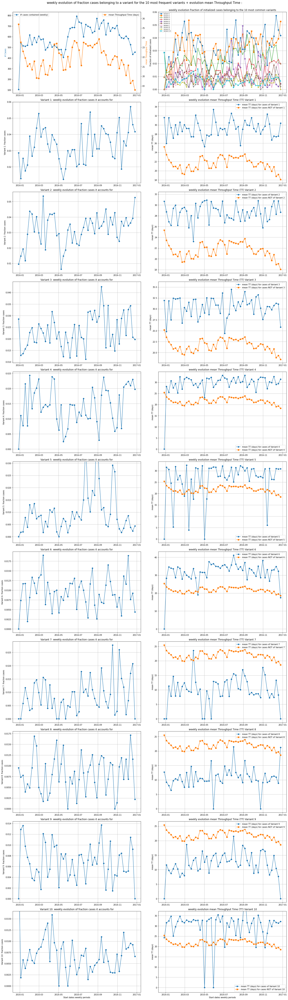

In [6]:
bpic17_plots.topK_variants_evol(plt_type = 'type_tt')

#### 1.2 Representation type : __Outcome__ 

##### 1.2.A: Outcome - __'case accepted'__

c:\Users\Brecht\anaconda3\envs\BPIC_2017\lib\site-packages\pandas\core\common.py:241: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  result = np.asarray(values, dtype=dtype)
Computing additional weekly outcome aggregations for each of the 10 most frequently occurring variants: 100%|██████████| 10/10 [00:00<00:00, 39.77it/s]


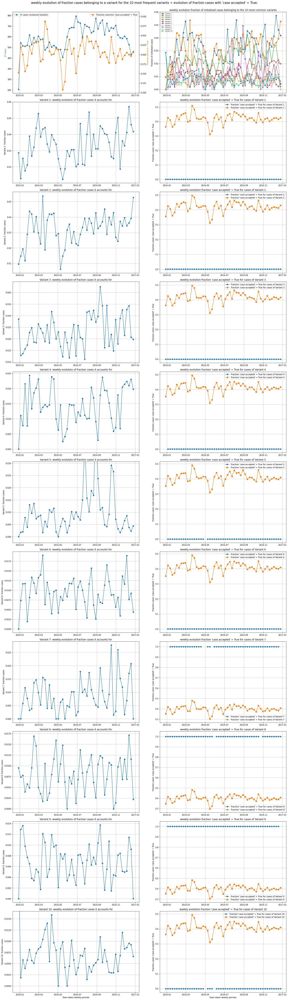

In [7]:
bpic17_plots.topK_variants_evol(plt_type = 'type_outcome')

##### 1.2.B: Outcome - __'case refused'__

c:\Users\Brecht\anaconda3\envs\BPIC_2017\lib\site-packages\pandas\core\common.py:241: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  result = np.asarray(values, dtype=dtype)
Computing additional weekly outcome aggregations for each of the 10 most frequently occurring variants: 100%|██████████| 10/10 [00:00<00:00, 40.46it/s]


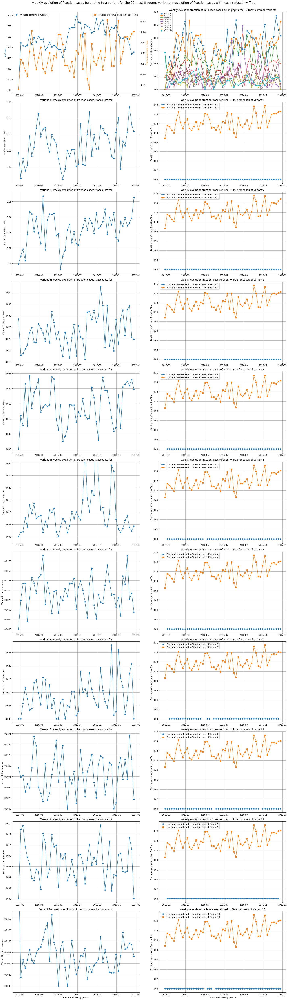

In [8]:
bpic17_plots.set_outcomeColumn(outcome = 'case refused')
bpic17_plots.topK_variants_evol(plt_type = 'type_outcome')

##### 1.2.C: Outcome - __'case canceled'__

c:\Users\Brecht\anaconda3\envs\BPIC_2017\lib\site-packages\pandas\core\common.py:241: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  result = np.asarray(values, dtype=dtype)
Computing additional weekly outcome aggregations for each of the 10 most frequently occurring variants: 100%|██████████| 10/10 [00:00<00:00, 34.55it/s]


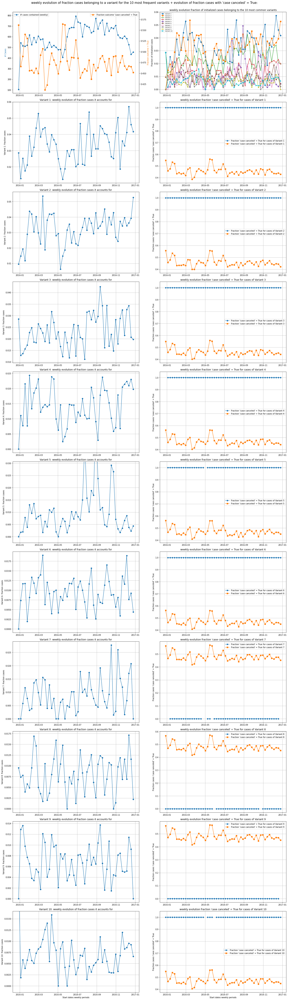

In [9]:
bpic17_plots.set_outcomeColumn(outcome = 'case canceled')
bpic17_plots.topK_variants_evol(plt_type = 'type_outcome')

## __2. Categorical Case Features__ 
The BPIC17 event log intrinsically has 2 categorical case features, `'case:LoanGoal'` and `'case:ApplicationType'`. As already mentioned, each loan application / case can have one of 3 possible outcomes, namely 'Accepted', 'Refused' and 'Canceled'. Next to the 3 binary outcome features, also an additional categorical feature `'case:outcome'` was constructed. This feature indicates for every case the outcome, and hence has 3 distinct levels. By constructing this additional feature, we can examine whether there are potential interrelations between the outcome and the throughput time of cases, and the outcome and the case length (NEPC), as well as possible trends and changes in these interrelations over time. 

### __2.1 Categorical Case Features: 'case:outcome'__
The following interesting trends and patterns were observed for the 3 possible outcomes of cases: 
1. __Fraction of cases__: 47% of the cases in the BPIC17 are __'Canceled'__, 41% __'Accepted'__ and 12% __'Refused'__. This pattern remains relatively stable over time. 
1. [__Mean Throughput Time (TT) cases of a certain outcome vs mean TT all other cases__](#211-caseoutcome---representation-type-throughput-time-tt):
    - **'Canceled'**: The weekly mean TT of loan applications that end up being canceled is consistently and significantly **higher** compared to cases that do not. 
    - **'Accepted'**: The weekly mean TT of loan applications that end up being accepted is consistently and significantly **lower** compared to cases that do not. This is primarily due to the significantly larger TT needed for the __'Canceled'__ loan applications, which accounts for the majority of cases.  
1. [__Mean Case Length (in number of events per case, aka NEPC) cases pertaining to a certain level vs. mean NEPC all other cases__](#212-caseoutcome---representation-type-case-length-nepc): In contrast to the weekly mean TT, the weekly mean NEPC of **'Canceled'** cases is significantly and almost consistently lower compared to the mean NEPC of other cases, while the opposite holds for **'Accepted'** cases. 

#### __2.1.1 'case:outcome'__ - Representation type: __Throughput Time (TT)__

Computing additional weekly aggregations of the Throughput Time for each of the 3 most frequently occurring levels: 100%|██████████| 3/3 [00:00<00:00, 94.45it/s]


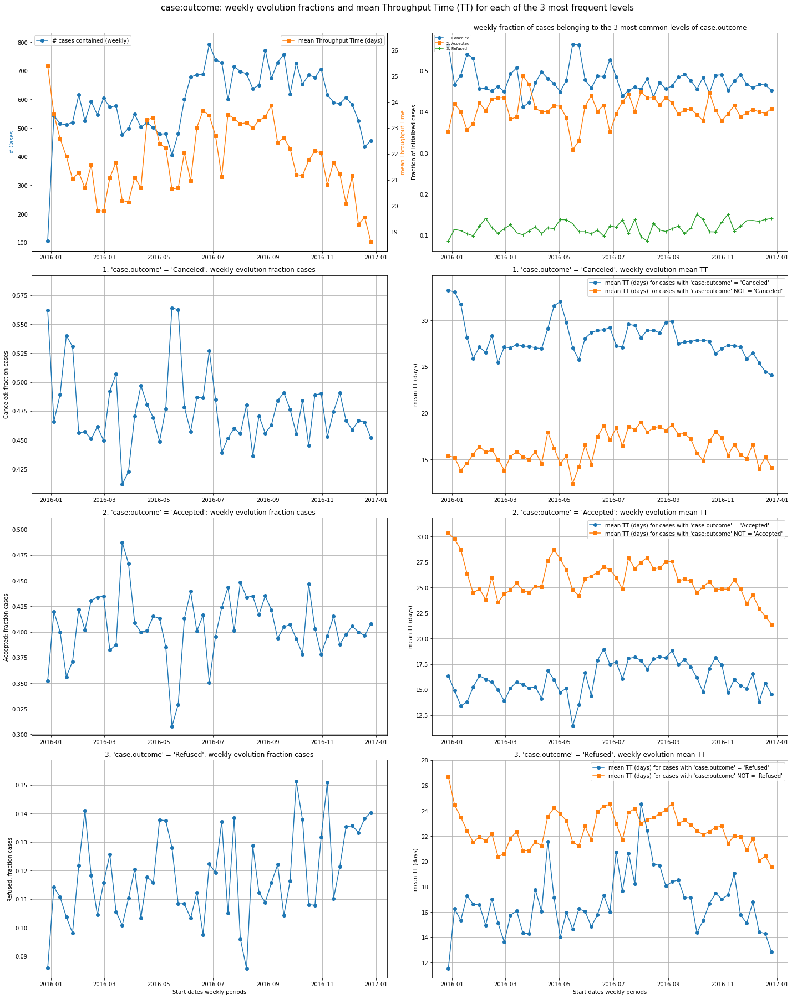

In [10]:
bpic17_plots.topK_categorical_caseftr_evol(case_feature = 'case:outcome', plt_type = 'type_tt')

#### __2.1.2 'case:outcome'__ - Representation type: __Case Length (NEPC)__

Computing additional weekly aggregations of the Number of Events Per Case (NEPC) for each of the 3 most frequently occurring levels: 100%|██████████| 3/3 [00:00<00:00, 92.11it/s]


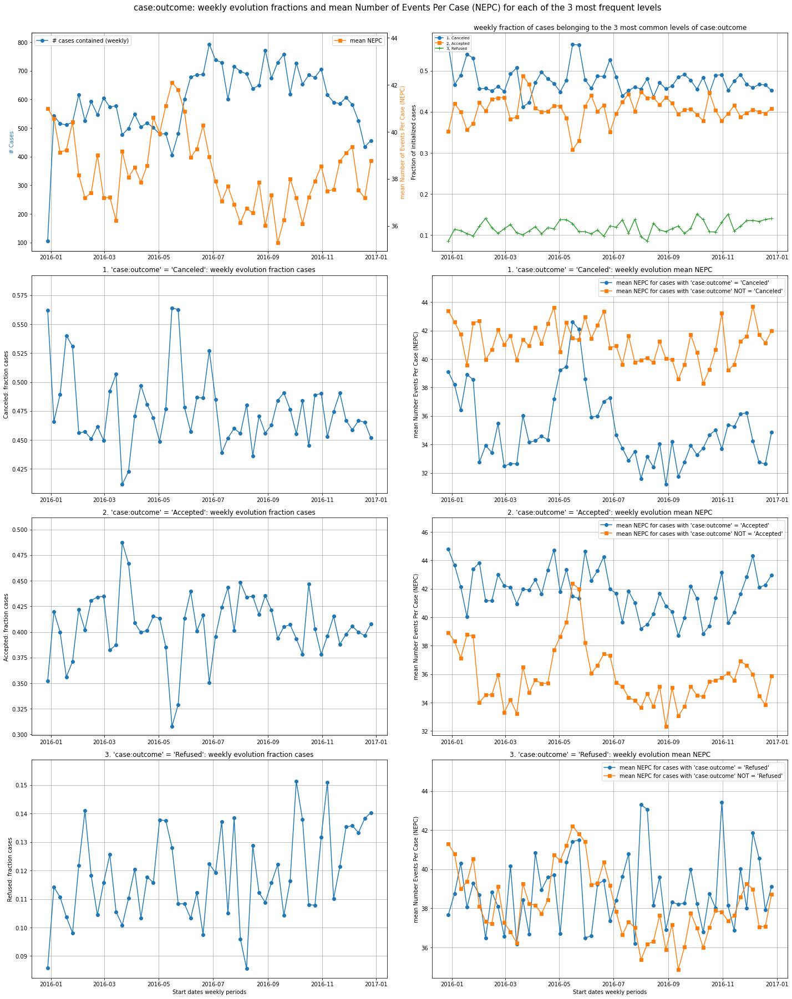

In [11]:
bpic17_plots.topK_categorical_caseftr_evol(case_feature = 'case:outcome', plt_type = 'type_events_case')

### __2.2 Categorical Case Features: 'case:LoanGoal'__
Categorical case feature __'case:LoanGoal'__ has 14 distinct levels. We examine the dynamics over time for the top 10 most frequently occurring levels. The following interesting trends and patterns were observed: 
1. [__Mean Throughput Time (TT) cases of a certain outcome vs mean TT all other cases__](#221-caseloangoal---representation-type-throughput-time-tt): Although quite some variability can be observed in the time series, it becomes apparant that some levels on average indeed need more or less time to complete compared to others. In the second cell, we have changed the `frequency` parameter from `'weekly'` to `'2-weekly'` to filter out some noise. These plots lead to the same observation. 

1. [__Mean Case Length (in number of events per case, aka NEPC) cases pertaining to a certain level vs. mean NEPC all other cases__](#222-caseloangoal---representation-type-case-length-nepc): Similar observations can be made for the relation between the levels of __'case:LoanGoal'__ and the weekly mean NEPC. 

1. [__Outcome - Fraction of 'positive' cases pertaining to a certain level vs. fraction of positives among all other cases__](#223-caseloangoal---representation-type-outcome): 
    - [__Outcome = 'case accepted'__](#223a-outcome---case-accepted): The most occurring level __'Car'__ on average gets slightly less accepted compared to all other levels. While the second most occurring level '__Home improvement'__  on average gets accepted more. These patterns remain relatively stable over time. The fifth most occurring level '__Unknown__' gets significantly more accepted, in contrast to the sixth most occurring level '__Not specified'__. 
    
    - [__Outcome = 'case refused'__](#223b-outcome---case-refused): Only about 12% of cases gets refused. No reasonably consistent / representative patterns, trends or changes can be observed. 

    - [__Outcome = 'case canceled'__](#223c-outcome---case-canceled): The significant patterns observed for __Outcome = 'case accepted'__ emerge again for __Outcome = 'case canceled'__, but in a reversed way. This could be expected, since on average 47% of cases gets __'Canceled'__, and 41% gets __'Accepted'__. 

#### __2.2.1 'case:LoanGoal'__ - Representation type: __Throughput Time (TT)__

Computing additional weekly aggregations of the Throughput Time for each of the 10 most frequently occurring levels: 100%|██████████| 10/10 [00:00<00:00, 75.10it/s]


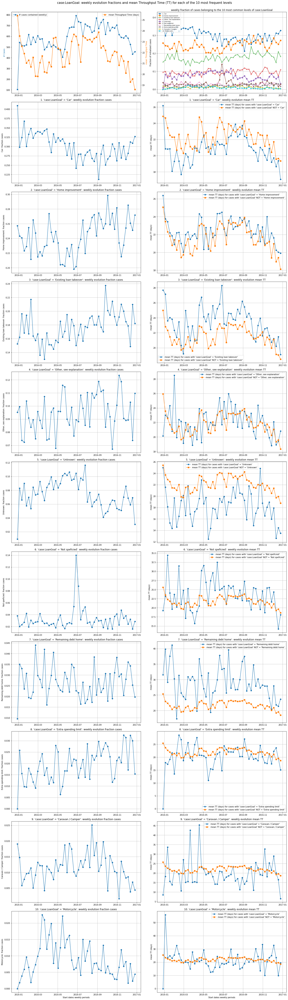

In [57]:
bpic17_plots.topK_categorical_caseftr_evol(case_feature = 'case:LoanGoal', plt_type = 'type_tt', xtr_outlier_rem = False)

Computing additional 2-weekly aggregations of the Throughput Time for each of the 10 most frequently occurring levels: 100%|██████████| 10/10 [00:00<00:00, 74.66it/s]


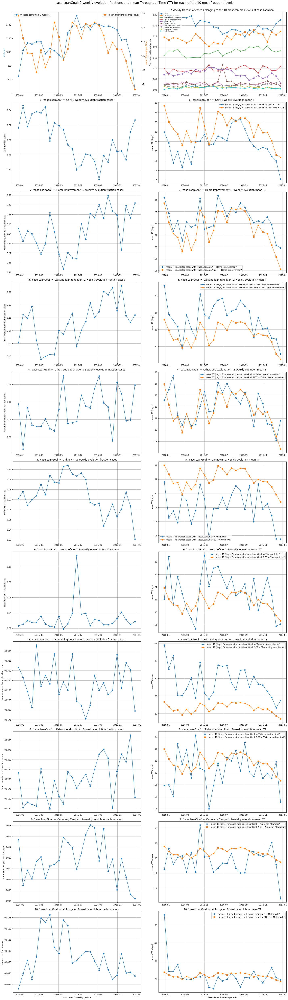

In [58]:
bpic17_plots.topK_categorical_caseftr_evol(case_feature = 'case:LoanGoal', frequency = '2-weekly', plt_type = 'type_tt', xtr_outlier_rem = False)

#### __2.2.2 'case:LoanGoal'__ - Representation type: __Case Length (NEPC)__

Computing additional weekly aggregations of the Number of Events Per Case (NEPC) for each of the 10 most frequently occurring levels: 100%|██████████| 10/10 [00:00<00:00, 80.67it/s]


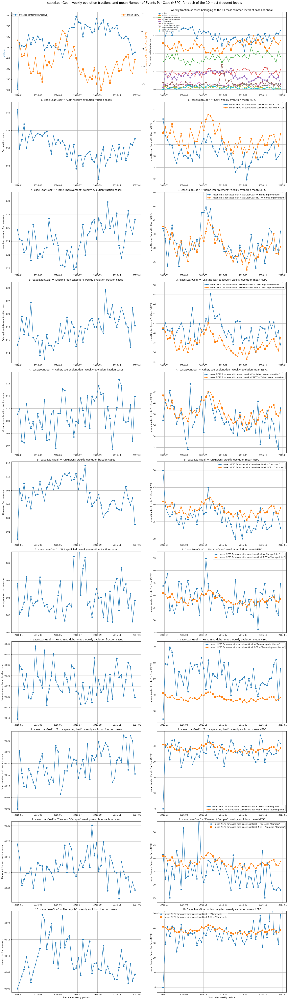

In [13]:
bpic17_plots.topK_categorical_caseftr_evol(case_feature = 'case:LoanGoal', plt_type = 'type_events_case')

#### __2.2.3 'case:LoanGoal'__ - Representation type: __Outcome__

##### 2.2.3.A Outcome - __'case accepted'__

Computing additional weekly outcome aggregations for each of the 10 most frequently occurring levels: 100%|██████████| 10/10 [00:00<00:00, 27.71it/s]


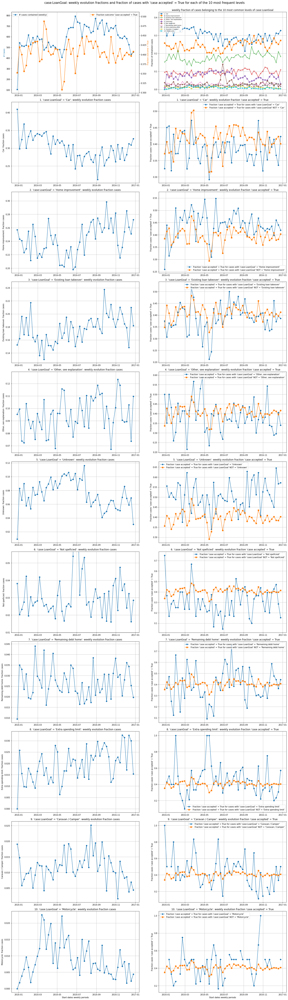

In [14]:
bpic17_plots.set_outcomeColumn(outcome = 'case accepted')
bpic17_plots.topK_categorical_caseftr_evol(case_feature = 'case:LoanGoal', plt_type = 'type_outcome')

Computing additional 2-weekly outcome aggregations for each of the 10 most frequently occurring levels: 100%|██████████| 10/10 [00:00<00:00, 31.26it/s]


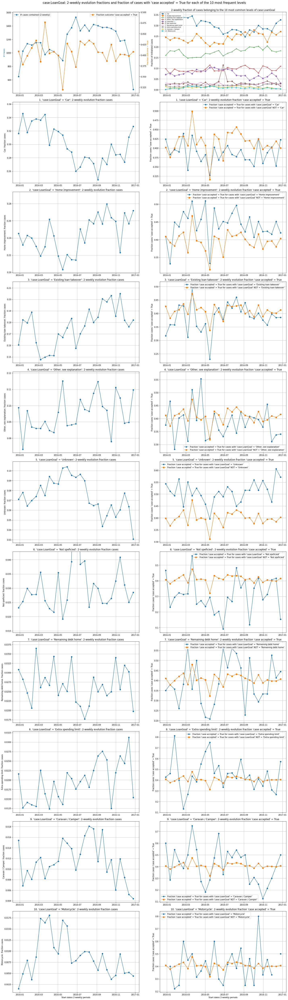

In [59]:
bpic17_plots.set_outcomeColumn(outcome = 'case accepted')
bpic17_plots.topK_categorical_caseftr_evol(case_feature = 'case:LoanGoal', frequency = '2-weekly', plt_type = 'type_outcome')

##### 2.2.3.B Outcome - __'case refused'__

Computing additional 2-weekly outcome aggregations for each of the 10 most frequently occurring levels: 100%|██████████| 10/10 [00:00<00:00, 18.09it/s]


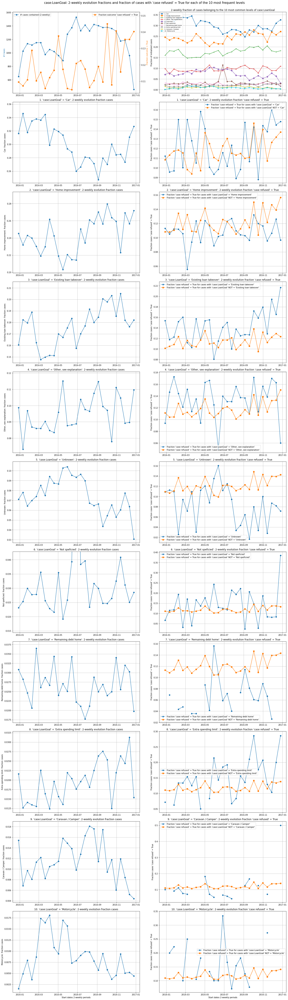

In [60]:
bpic17_plots.set_outcomeColumn(outcome = 'case refused')
bpic17_plots.topK_categorical_caseftr_evol(case_feature = 'case:LoanGoal', plt_type = 'type_outcome', frequency = '2-weekly')

##### 2.2.3.C Outcome - __'case canceled'__

Computing additional weekly outcome aggregations for each of the 10 most frequently occurring levels: 100%|██████████| 10/10 [00:00<00:00, 28.20it/s]


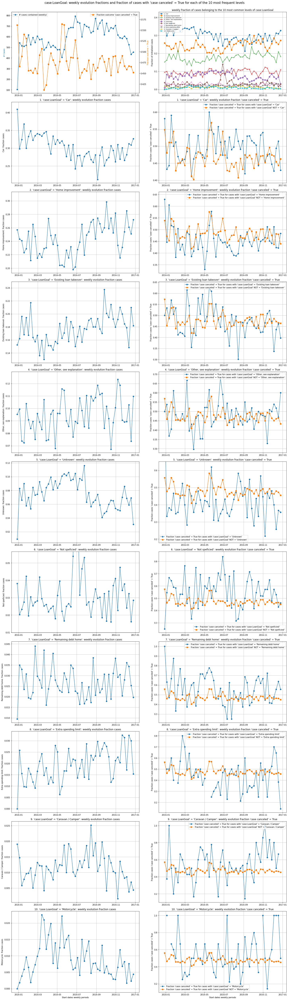

In [16]:
bpic17_plots.set_outcomeColumn(outcome = 'case canceled')
bpic17_plots.topK_categorical_caseftr_evol(case_feature = 'case:LoanGoal', plt_type = 'type_outcome')

### __2.3 Categorical Case Features: 'case:ApplicationType'__
Categorical case feature __'case:ApplicationType''__ has only 2 distinct levels, _'New credit'_ and '_Limit raise_'. The following interesting trends and patterns were observed: 
1. __Fraction of cases belonging to each level__: 89% of cases pertain to the _'New credit'_ level, and only 11% to the '_Limit raise_' level. However, a slight increase in the weekly fraction of cases pertaining to _'New credit'_, and hence also a slight decrease in the fraction of cases pertaining to '_Limit raise_', can be observed. 
1. [__Mean Throughput Time (TT) cases of a certain outcome vs mean TT all other cases__](#231-caseapplicationtype---representation-type-throughput-time-tt): The weekly mean TT needed to complete cases pertaining to the minority level '_Limit raise_' is significantly and consistently smaller than the mean TT needed to complete cases pertaining to the majority level. 

1. [__Mean Case Length (in number of events per case, aka NEPC) cases pertaining to a certain level vs. mean NEPC all other cases__](#232-caseapplicationtype---representation-type-case-length-nepc): Similar observations can be made for the relation between the 2 levels and the weekly mean NEPC. 

1. [__Outcome - Fraction of 'positive' cases pertaining to a certain level vs. fraction of positives among all other cases__](#233-caseapplicationtype---representation-type-outcome): 
    - [__Outcome = 'case accepted'__](#233a-outcome---case-accepted): The fraction of cases that pertain to the minorty level ('_Limit raise_') and get accepted, is significantly larger than the fraction of _'New credit'_ cases that get accepted. This pattern remains relatively stable over time. The opposite holds for __outcome = 'case refused'__ and __outcome = 'case canceled'__. 
    
    - [__Outcome = 'case refused'__](#233b-outcome---case-refused): See supra.

    - [__Outcome = 'case canceled'__](#233c-outcome---case-canceled): See supra. 

#### __2.3.1 'case:ApplicationType'__ - Representation type: __Throughput Time (TT)__

Computing additional 2-weekly aggregations of the Throughput Time for each of the 2 most frequently occurring levels: 100%|██████████| 2/2 [00:00<00:00, 115.75it/s]


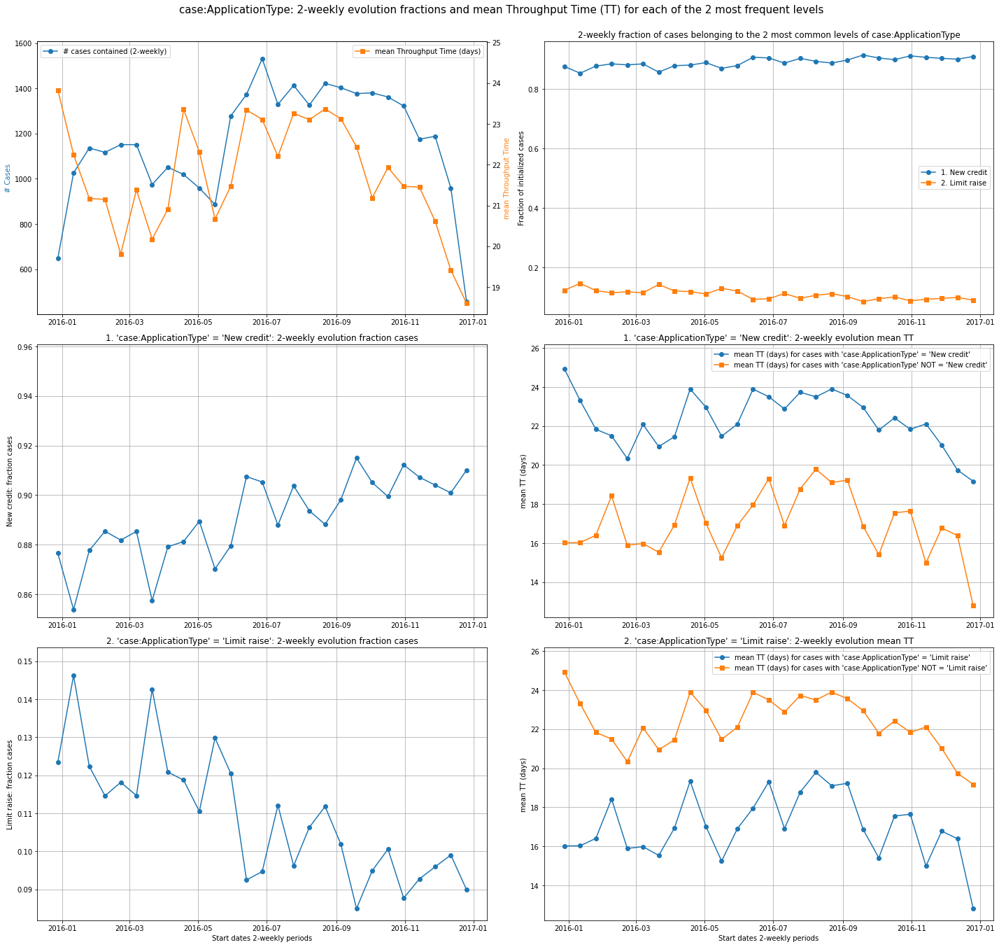

In [17]:
bpic17_plots.topK_categorical_caseftr_evol(case_feature = 'case:ApplicationType', frequency = '2-weekly', plt_type = 'type_tt')

#### __2.3.2 'case:ApplicationType'__ - Representation type: __Case Length (NEPC)__

Computing additional weekly aggregations of the Number of Events Per Case (NEPC) for each of the 2 most frequently occurring levels: 100%|██████████| 2/2 [00:00<00:00, 103.56it/s]


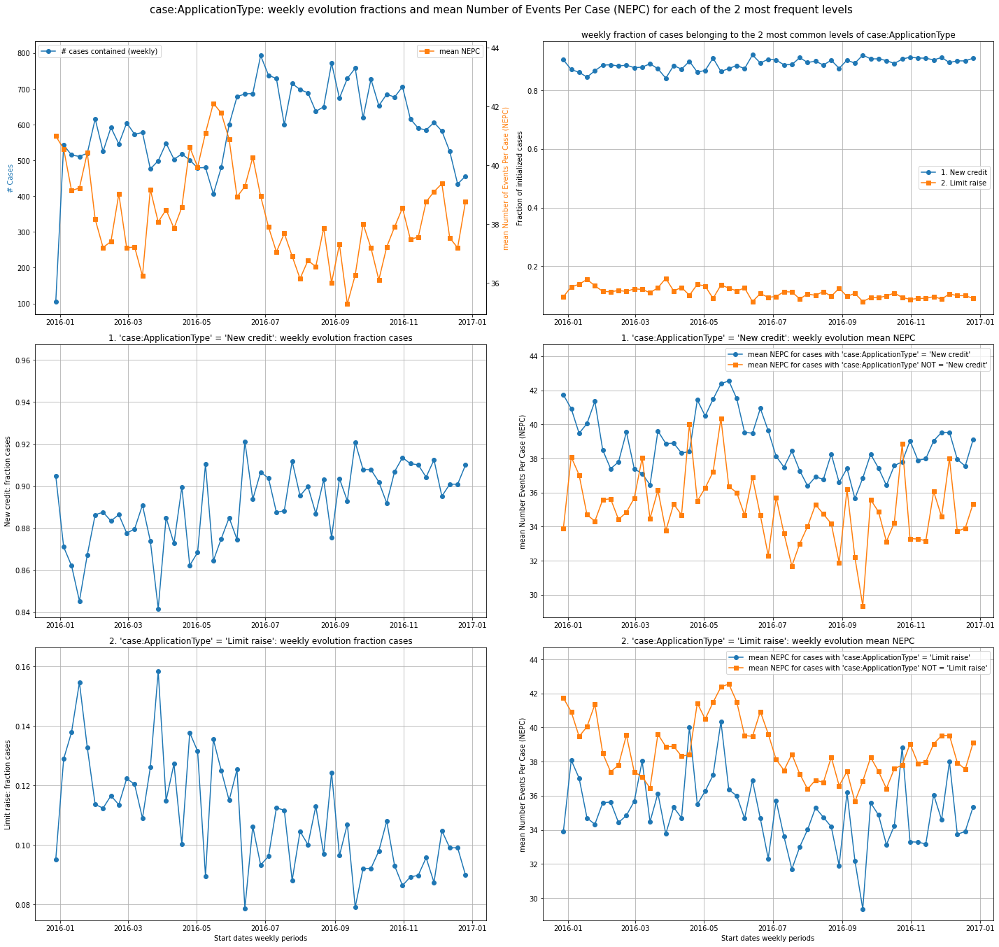

In [18]:
bpic17_plots.topK_categorical_caseftr_evol(case_feature = 'case:ApplicationType', plt_type = 'type_events_case')

#### __2.3.3 'case:ApplicationType'__ - Representation type: __Outcome__

##### 2.3.3.A Outcome - __'case accepted'__

Computing additional weekly outcome aggregations for each of the 2 most frequently occurring levels: 100%|██████████| 2/2 [00:00<00:00, 29.72it/s]


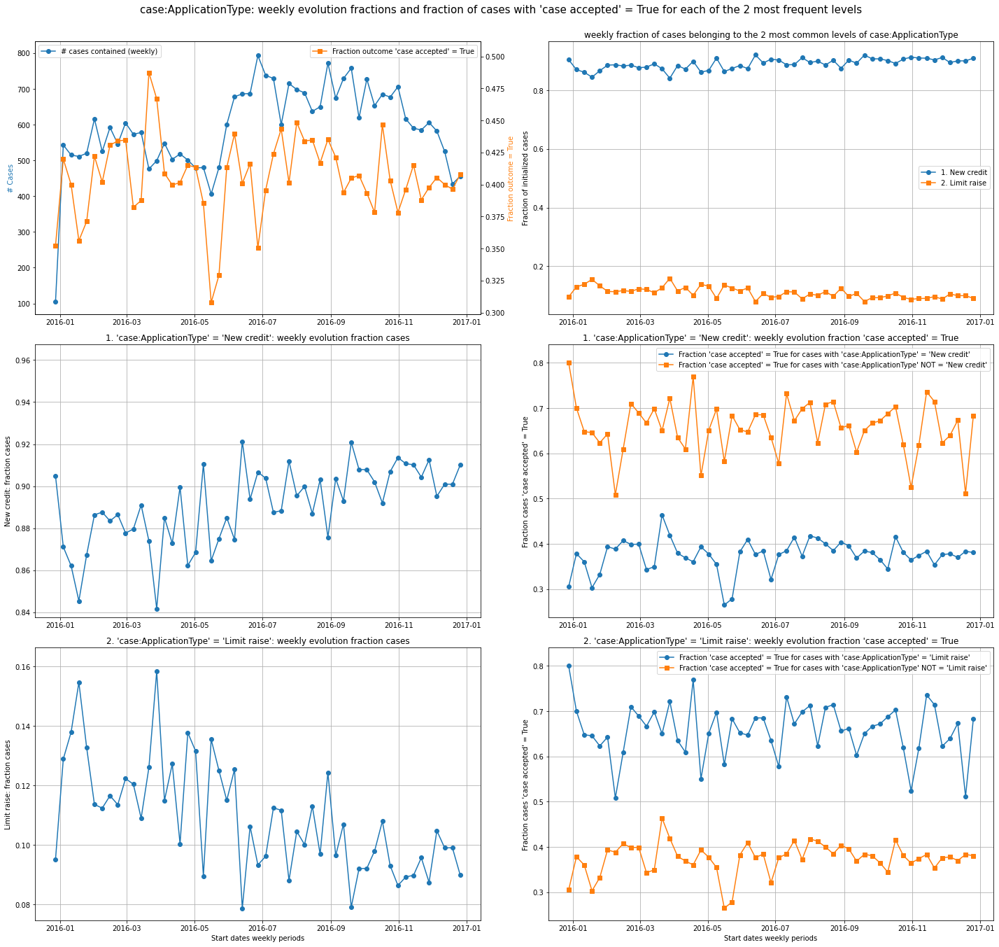

In [19]:
bpic17_plots.set_outcomeColumn(outcome = 'case accepted')
bpic17_plots.topK_categorical_caseftr_evol(case_feature = 'case:ApplicationType', plt_type = 'type_outcome')

##### 2.3.3.B Outcome - __'case refused'__

Computing additional 2-weekly outcome aggregations for each of the 2 most frequently occurring levels: 100%|██████████| 2/2 [00:00<00:00, 20.22it/s]


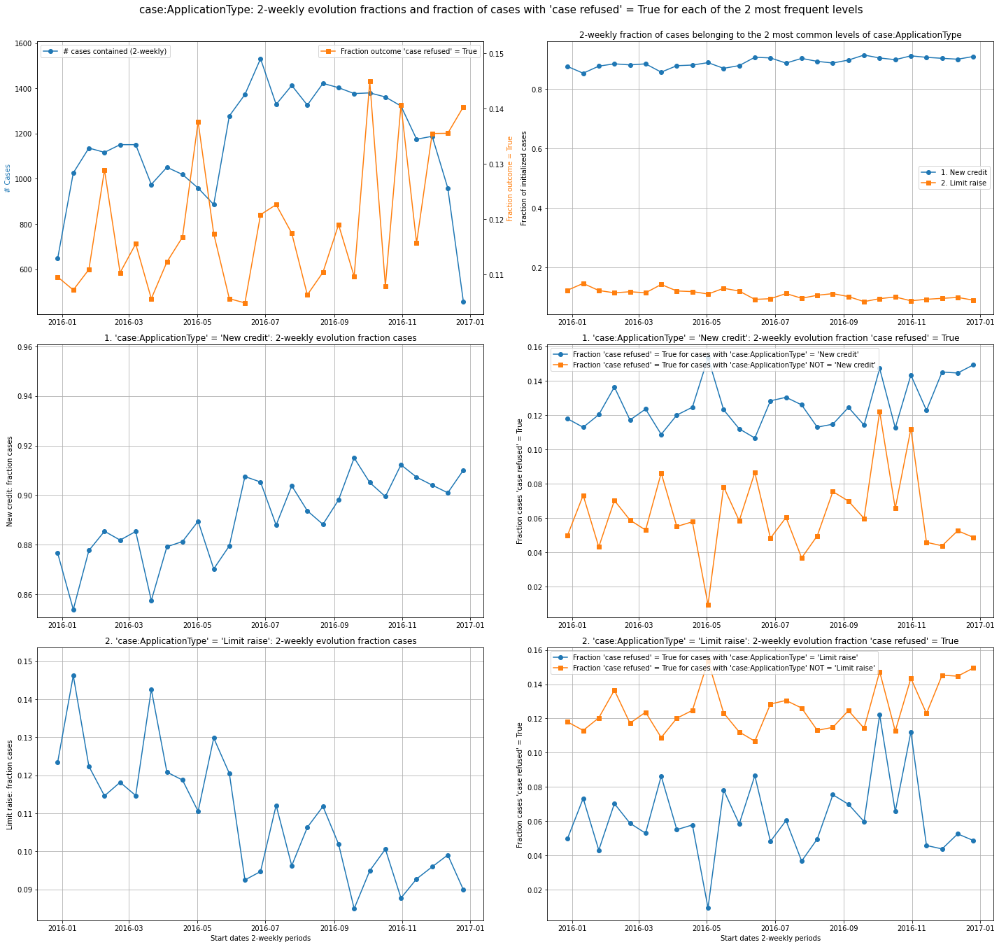

In [71]:
bpic17_plots.set_outcomeColumn(outcome = 'case refused')
bpic17_plots.topK_categorical_caseftr_evol(case_feature = 'case:ApplicationType', plt_type = 'type_outcome', 
                                           frequency = '2-weekly')

##### 2.3.3.C Outcome - __'case canceled'__

Computing additional weekly outcome aggregations for each of the 2 most frequently occurring levels: 100%|██████████| 2/2 [00:00<00:00, 26.04it/s]


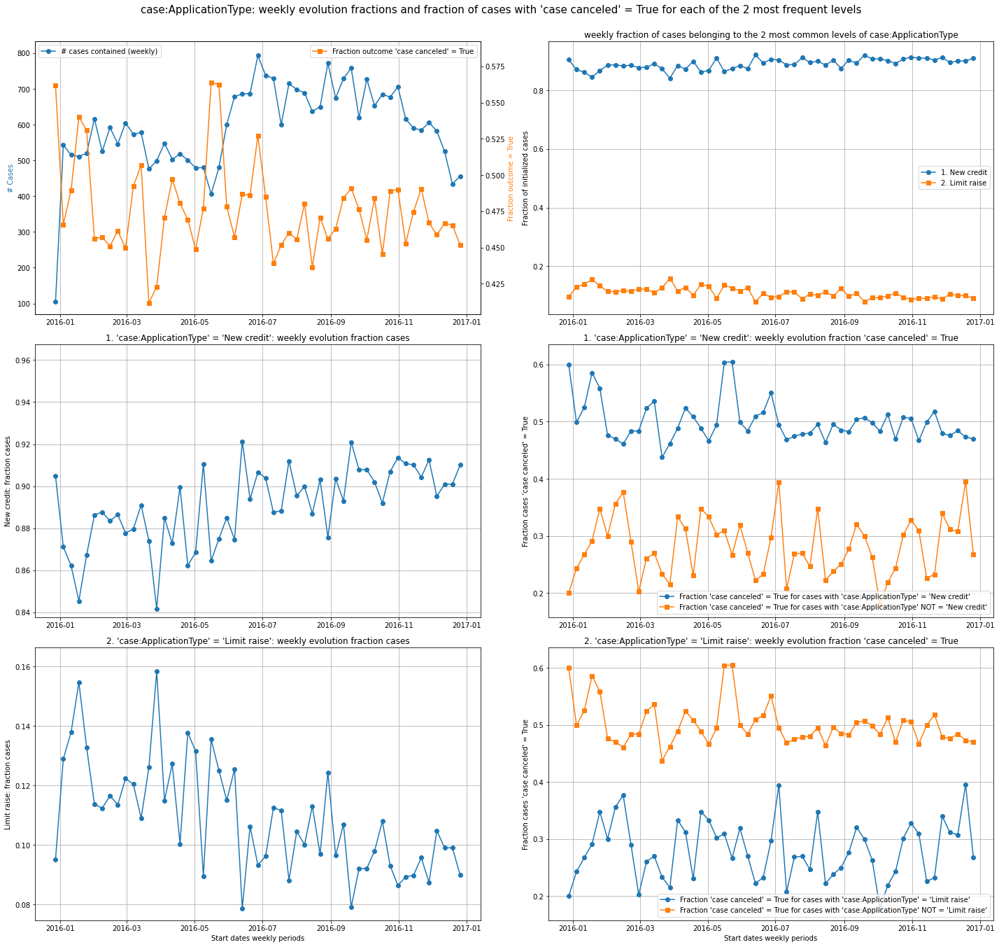

In [21]:
bpic17_plots.set_outcomeColumn(outcome = 'case canceled')
bpic17_plots.topK_categorical_caseftr_evol(case_feature = 'case:ApplicationType', plt_type = 'type_outcome')

## __3. Numeric Case Features__
>BPIC17 has only 1 numeric case feature, being `'case:RequestedAmount'`, indicating each case's (/loan application's) requested amount. The following interesting trends and patterns were observed: 
1. __Mean value `'case:RequestedAmount'`__: A significant increasing trend of the requested amount of loan applications over time can be observed. 
1. [__Mean (case-level) ratio of *Throughput Time (TT)* / *unit 'case:RequestedAmount'*__](#31-caserequestedamount---representation-type-throughput-time-tt): Weekly mean ratio of the amount of TT needed per unit of `'case:RequestedAmount'` decreases over time. This could be expected, given the increasing trend of `'case:RequestedAmount'` and the observed evolution of the mean TT over time. 

1. [__Mean (case-level) ratio *NEPC* / *10^{x} units 'case:RequestedAmount'*__](#32-caserequestedamount---representation-type-case-length-nepc): Similar observations can be made for the NEPC ratio. 

1. [__Outcome - Mean value *unit 'case:RequestedAmount'* for 'positive' cases vs. mean for 'negative' cases__](#33-caserequestedamount---representation-type-outcome): 
    - [__Outcome = 'case accepted'__](#33a-outcome---case-accepted): No consistent and significant difference can be observed between the mean value of `'case:RequestedAmount'` for cases that are and are not accepted. 
    
    - [__Outcome = 'case refused'__](#33b-outcome---case-refused): Weekly mean value of `'case:RequestedAmount'` seems to be slightly lower for cases that are refused than for cases that are not refused (and hence either canceled or accepted). This seems counterintuitive. However, one should keep in mind that on average only 12% of all cases are refused. Therefore, the weekly and 2-weekly samples of refused cases might not be very representative. Finally, also a sudden peak in the mean `'case:RequestedAmount'` can be observed around *2016-11-14*. After examining the observed values in the corresponding sample, it became apparant that this outlier is mainly due to one single but very extreme outlier. 

    - [__Outcome = 'case canceled'__](#33c-outcome---case-canceled): Especially during the last few months, the weekly mean `'case:RequestedAmount'` seems to be slightly higher for canceled cases. Whether or not this difference is significant or just noise remains unclear. 

### __3.1 'case:RequestedAmount'__ - Representation type: __Throughput Time (TT)__

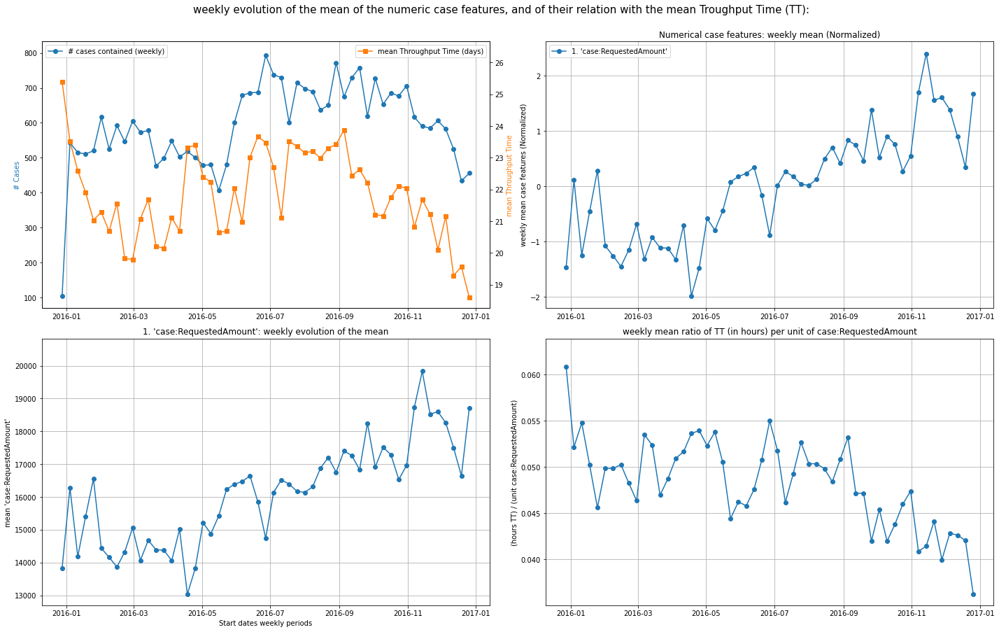

In [22]:
bpic17_plots.num_casefts_evol(numeric_case_list = numeric_casefeatures, plt_type = 'type_tt')

### __3.2 'case:RequestedAmount'__ - Representation type: __Case Length (NEPC)__

Computing the additional weekly NEPC aggregations for each of the 1 given numerical case features: 100%|██████████| 1/1 [00:00<00:00, 40.75it/s]


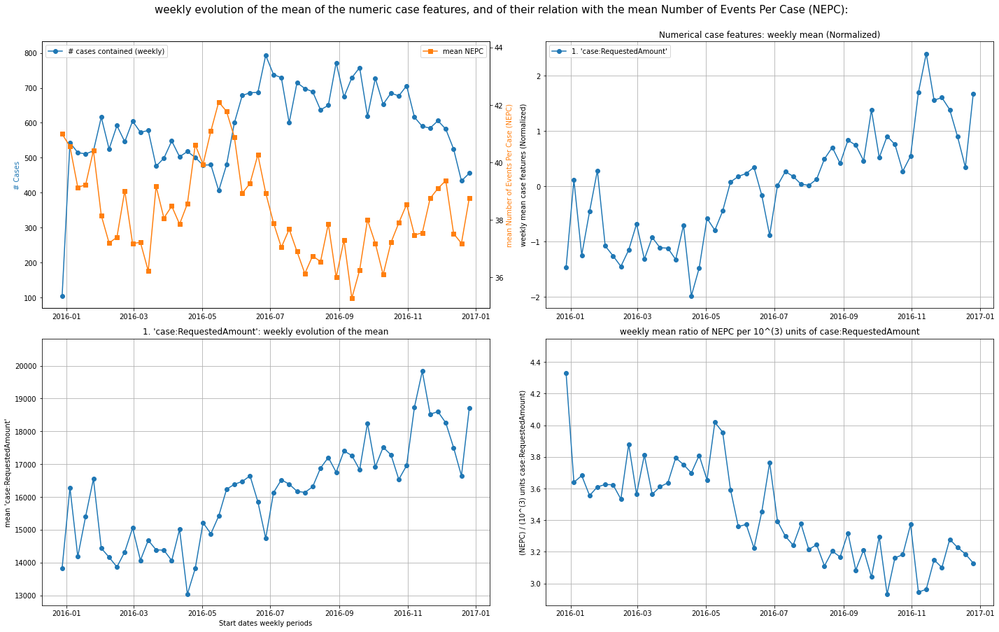

In [23]:
bpic17_plots.num_casefts_evol(numeric_case_list = numeric_casefeatures, plt_type = 'type_events_case')

### __3.3 'case:RequestedAmount'__ - Representation type: __Outcome__

#### 3.3.A: Outcome - __'case accepted'__

Computing the additional weekly outcome aggregations for each of the 1 given numerical case features: 100%|██████████| 1/1 [00:00<00:00,  9.36it/s]


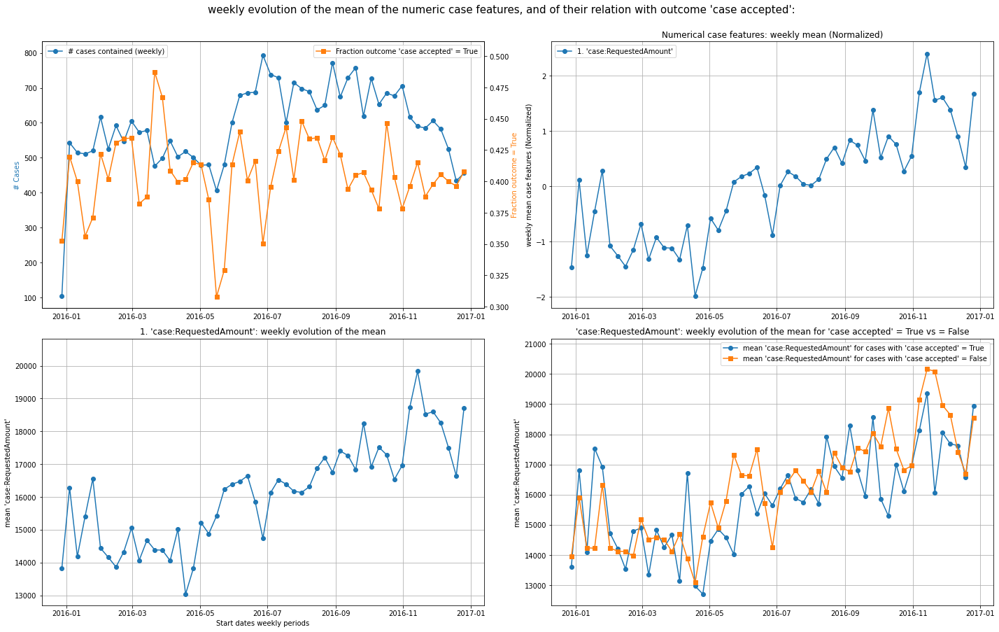

In [24]:
bpic17_plots.set_outcomeColumn(outcome = 'case accepted')
bpic17_plots.num_casefts_evol(numeric_case_list = numeric_casefeatures, plt_type = 'type_outcome')

Computing the additional 2-weekly outcome aggregations for each of the 1 given numerical case features: 100%|██████████| 1/1 [00:00<00:00, 37.67it/s]


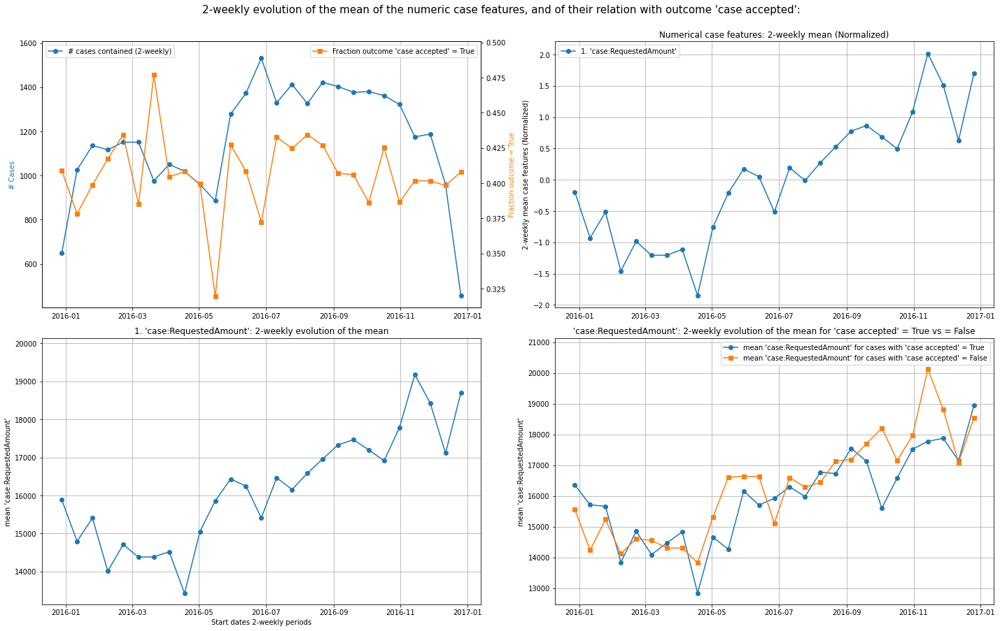

In [73]:
bpic17_plots.set_outcomeColumn(outcome = 'case accepted')
bpic17_plots.num_casefts_evol(numeric_case_list = numeric_casefeatures, plt_type = 'type_outcome', 
                              frequency = '2-weekly')

#### 3.3.B: Outcome - __'case refused'__

Computing the additional weekly outcome aggregations for each of the 1 given numerical case features: 100%|██████████| 1/1 [00:00<00:00, 43.89it/s]


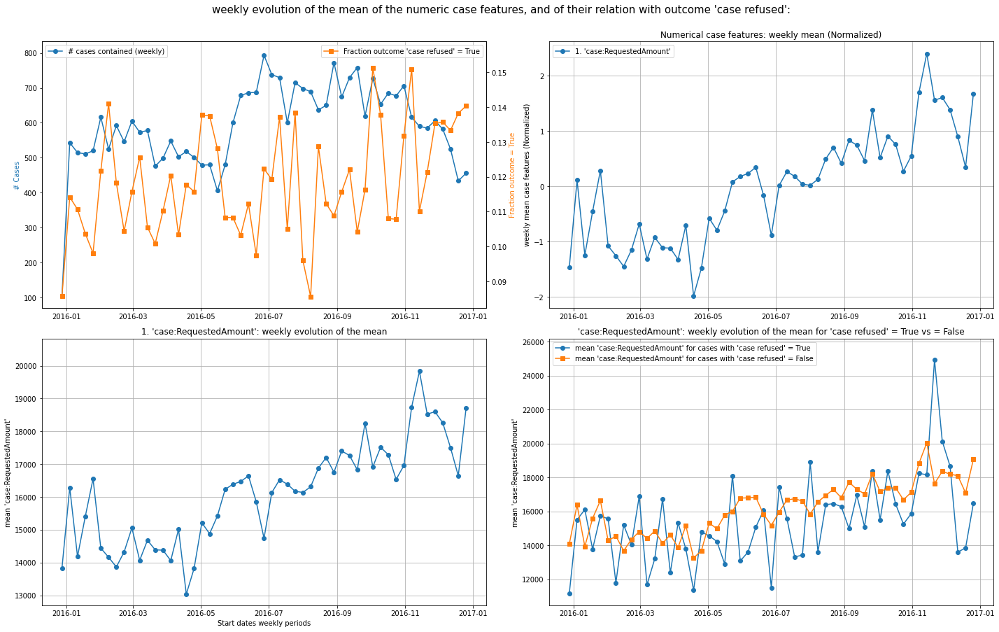

In [74]:
bpic17_plots.set_outcomeColumn(outcome = 'case refused')
bpic17_plots.num_casefts_evol(numeric_case_list = numeric_casefeatures, plt_type = 'type_outcome')

Computing the additional 2-weekly outcome aggregations for each of the 1 given numerical case features: 100%|██████████| 1/1 [00:00<00:00, 47.62it/s]


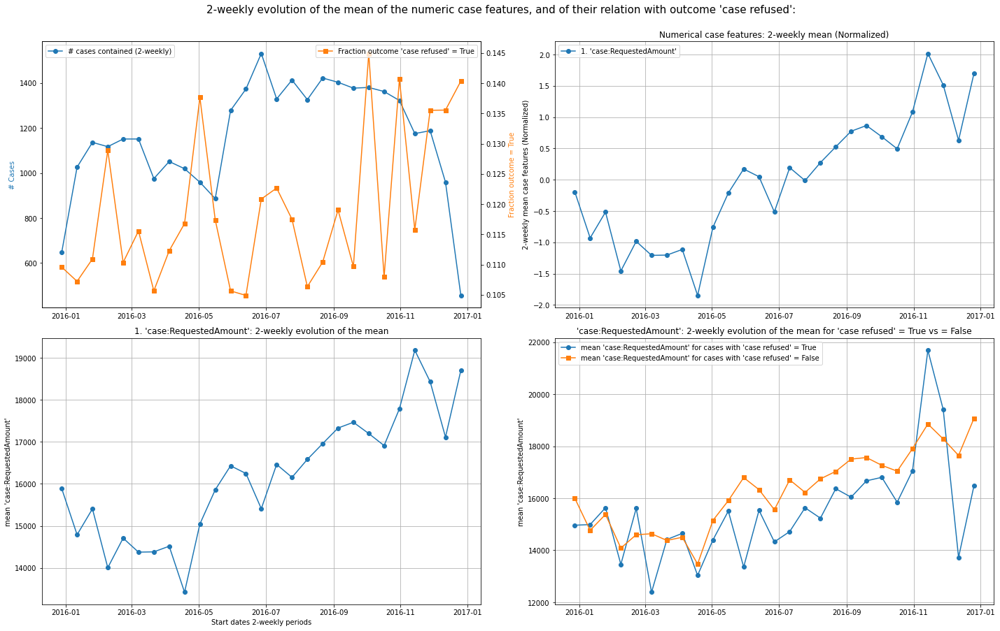

In [76]:
bpic17_plots.set_outcomeColumn(outcome = 'case refused')
bpic17_plots.num_casefts_evol(numeric_case_list = numeric_casefeatures, plt_type = 'type_outcome', 
                              frequency = '2-weekly', xtr_outlier_rem = False)

#### 3.3.C: Outcome - __'case canceled'__

Computing the additional weekly outcome aggregations for each of the 1 given numerical case features: 100%|██████████| 1/1 [00:00<00:00, 51.32it/s]


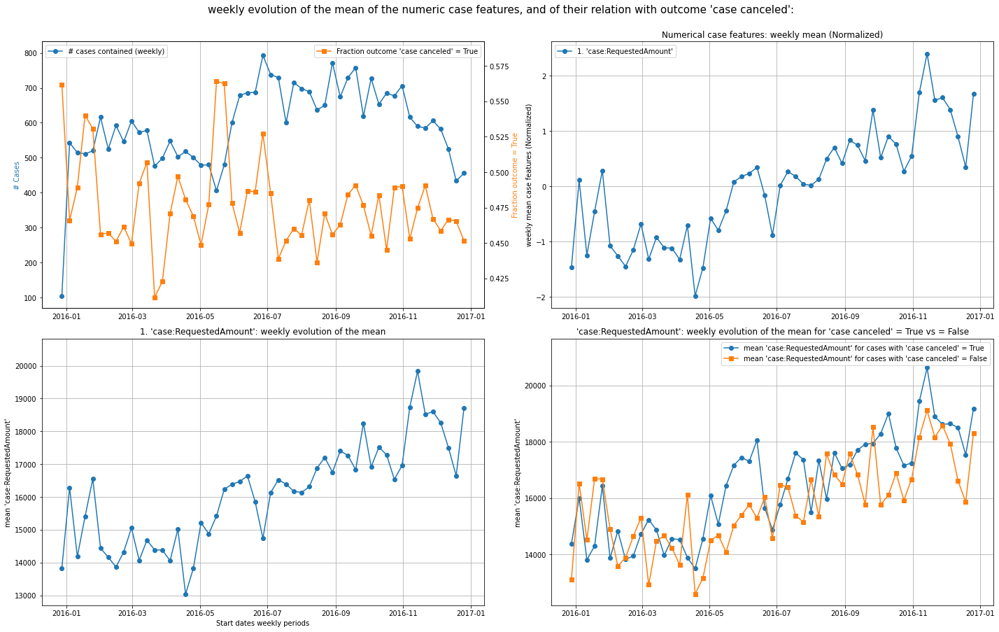

In [26]:
bpic17_plots.set_outcomeColumn(outcome = 'case canceled')
bpic17_plots.num_casefts_evol(numeric_case_list = numeric_casefeatures, plt_type = 'type_outcome')

Computing the additional 2-weekly outcome aggregations for each of the 1 given numerical case features: 100%|██████████| 1/1 [00:00<00:00, 44.81it/s]


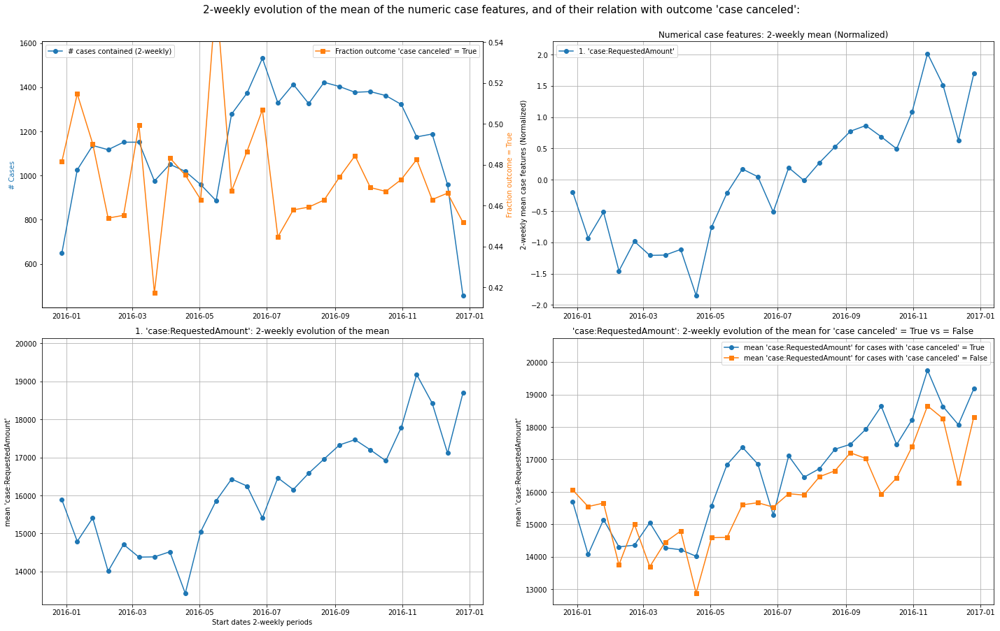

In [72]:
bpic17_plots.set_outcomeColumn(outcome = 'case canceled')
bpic17_plots.num_casefts_evol(numeric_case_list = numeric_casefeatures, plt_type = 'type_outcome', 
                              frequency = '2-weekly')

In [27]:
categorical_eventfeatures

['org:resource', 'Accepted', 'Selected', 'concept:name']

## __4. Categorical Event Features__

### __4.1 Categorical Event Features: 'org:resource'__
**'org:resource'** refers to the column containing information about the resource that executes a certain event. The BPIC17 event log contains 148 distinct resources. In this subsection, we investigate the dynamics for the 10 most frequently occurring resources over time. These 10 resources are responsible for over 28% of all activity executions. If you want to analyze more than only the 10 most frequently occurring levels, you can repeat these exeriments with the `max_k` parameter > 10.
The following interesting trends and patterns were observed: 
1. __Fraction cases in which a certain resource is involved in__:
    - A significant sudden and permanent drift in the fraction of cases is observed for the 4th and 5th most occurring resources ('User_87' and 'User_30' respectively). 
    - On a weekly basis, the most occurring resource ('User_1') takes part in approximately 70-75% of the cases. This time series remains relatively stable over time, except for the last 4 weeks, in which 'User_1' suddenly 'participates' in over 95% of the cases. 
    - For some other users *(e.g. the 8th most frequently occurring resource 'User_29')*, we can observe a significant but temporary drop in the fraction of cases they participate in. 
1. [__Mean Throughput Time (TT) cases in which a certain resource is involved in__](#411-orgresource---representation-type-throughput-time-tt): 
    - TO BE CONTINUED...

1. [__Mean Case Length (in number of events per case, aka NEPC) cases in which a certain resource is involved in__](#412-orgresource---representation-type-case-length-nepc): 
    - TO BE CONTINUED...

1. [__Outcome - Fraction of 'positive' cases among cases that a certain resource is involved in__](#413-orgresource---representation-type-outcome): 
    - [__Outcome = 'case accepted'__](#413a-outcome---case-accepted): TO BE CONTINUED... 
    
    - [__Outcome = 'case refused'__](#413b-outcome---case-refused): TO BE CONTINUED...

    - [__Outcome = 'case canceled'__](#413c-outcome---case-canceled): TO BE CONTINUED...

#### __4.1.1 'org:resource'__ - Representation type: __Throughput Time (TT)__

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'org:resource': 100%|██████████| 10/10 [00:00<00:00, 40.85it/s]


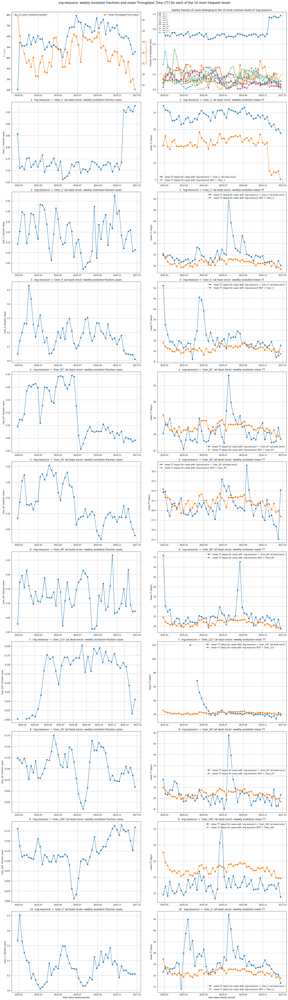

In [91]:
bpic17_plots.topK_categorical_eventftr_evol(event_feature = 'org:resource', plt_type = 'type_tt', xtr_outlier_rem=False)

#### __4.1.2 'org:resource'__ - Representation type: __Case Length (NEPC)__

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'org:resource': 100%|██████████| 10/10 [00:00<00:00, 57.56it/s]


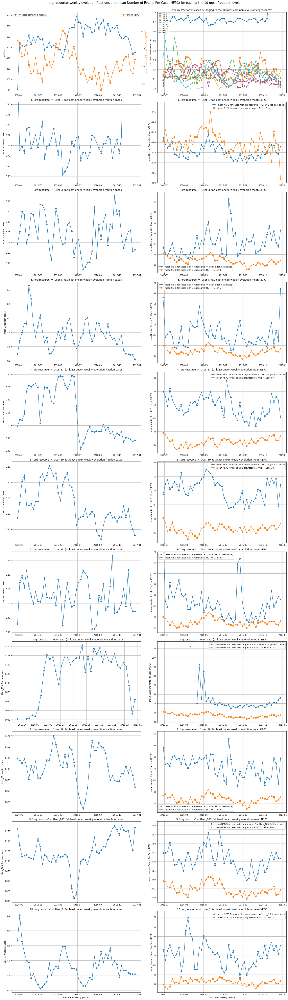

In [30]:
bpic17_plots.topK_categorical_eventftr_evol(event_feature = 'org:resource', plt_type = 'type_events_case')

#### __4.1.3 'org:resource'__ - Representation type: __Outcome__

##### 4.1.3.A Outcome - __'case accepted'__

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'org:resource': 100%|██████████| 10/10 [00:00<00:00, 32.59it/s]


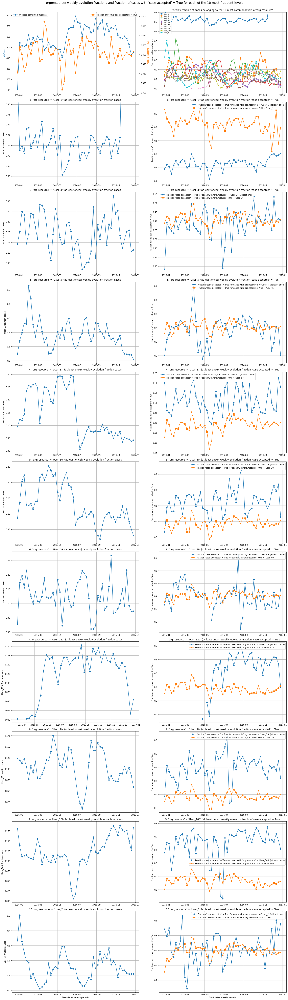

In [31]:
bpic17_plots.set_outcomeColumn(outcome = 'case accepted')
bpic17_plots.topK_categorical_eventftr_evol(event_feature = 'org:resource', plt_type = 'type_outcome')

##### 4.1.3.B Outcome - __'case refused'__

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'org:resource': 100%|██████████| 10/10 [00:00<00:00, 35.86it/s]


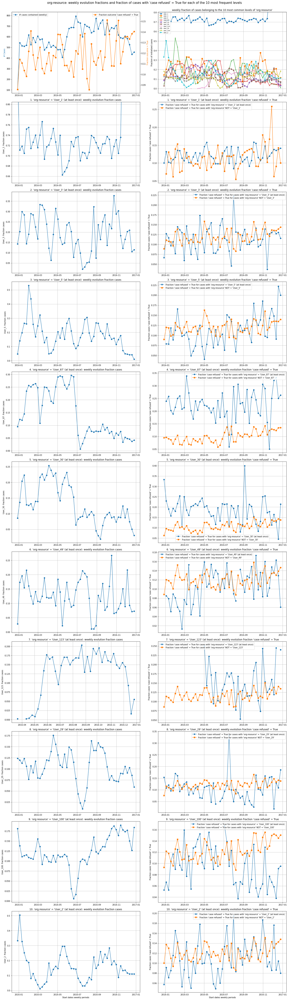

In [32]:
bpic17_plots.set_outcomeColumn(outcome = 'case refused')
bpic17_plots.topK_categorical_eventftr_evol(event_feature = 'org:resource', plt_type = 'type_outcome')

##### 4.1.3.C Outcome - __'case canceled'__

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'org:resource': 100%|██████████| 10/10 [00:00<00:00, 31.06it/s]


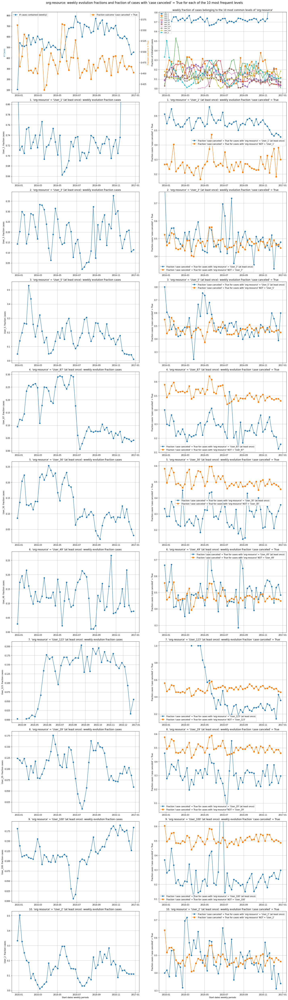

In [33]:
bpic17_plots.set_outcomeColumn(outcome = 'case canceled')
bpic17_plots.topK_categorical_eventftr_evol(event_feature = 'org:resource', plt_type = 'type_outcome')

### __4.2 Categorical Event Features: 'concept:name'__

#### __4.2.1 'concept:name'__ - Representation type: __Throughput Time (TT)__

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'concept:name': 100%|██████████| 10/10 [00:00<00:00, 56.38it/s]
c:\Users\Brecht\OneDrive\Documenten\2022-2023 PhD y1\DyLoPro_CaseStudies\DyLoPro\plotting_utils.py:294: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(agg_df_MinusFliers, axis=0)  # max_values: shape (num series, )


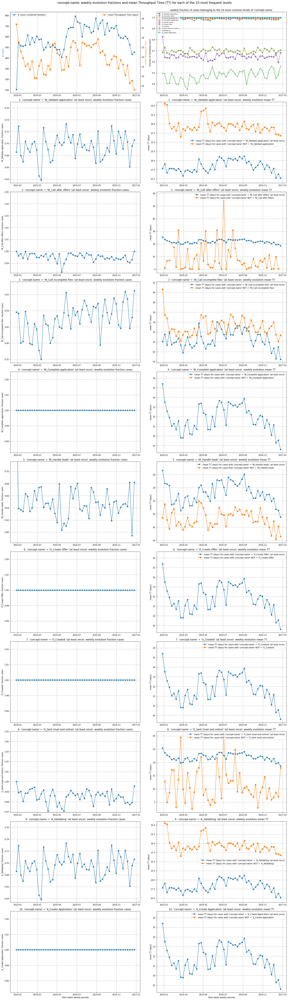

In [34]:
bpic17_plots.topK_categorical_eventftr_evol(event_feature = 'concept:name', plt_type = 'type_tt')

#### __4.2.2 'concept:name'__ - Representation type: __Case Length (NEPC)__

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'concept:name': 100%|██████████| 10/10 [00:00<00:00, 53.87it/s]
c:\Users\Brecht\OneDrive\Documenten\2022-2023 PhD y1\DyLoPro_CaseStudies\DyLoPro\plotting_utils.py:294: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(agg_df_MinusFliers, axis=0)  # max_values: shape (num series, )


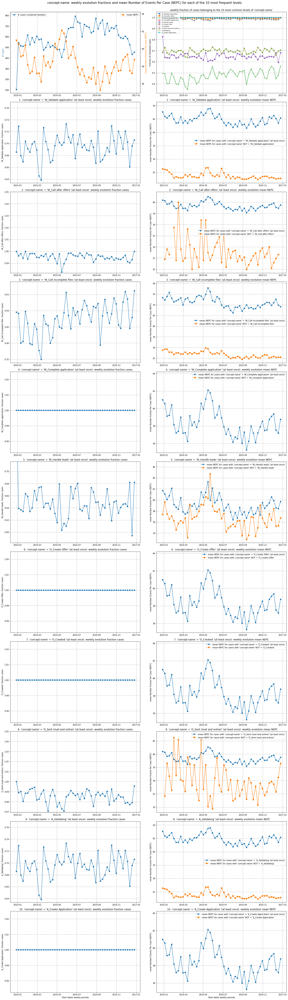

In [35]:
bpic17_plots.topK_categorical_eventftr_evol(event_feature = 'concept:name', plt_type = 'type_events_case')

#### __4.2.3 'concept:name'__ - Representation type: __Outcome__

##### 4.2.3.A Outcome - __'case accepted'__

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'concept:name': 100%|██████████| 10/10 [00:00<00:00, 31.83it/s]
c:\Users\Brecht\OneDrive\Documenten\2022-2023 PhD y1\DyLoPro_CaseStudies\DyLoPro\plotting_utils.py:294: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(agg_df_MinusFliers, axis=0)  # max_values: shape (num series, )


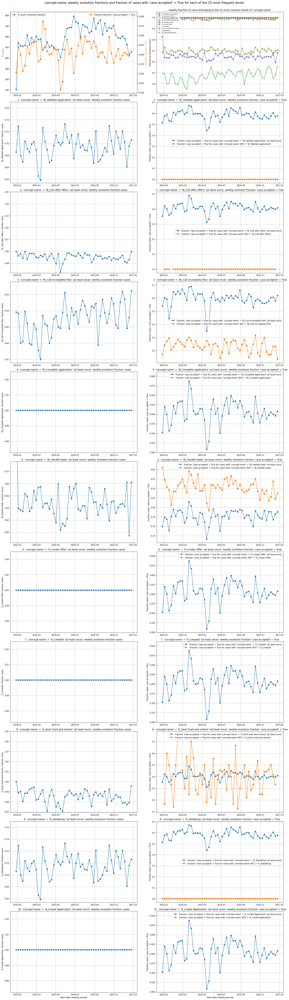

In [36]:
bpic17_plots.set_outcomeColumn(outcome = 'case accepted')
bpic17_plots.topK_categorical_eventftr_evol(event_feature = 'concept:name', plt_type = 'type_outcome')

##### 4.2.3.B Outcome - __'case refused'__

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'concept:name': 100%|██████████| 10/10 [00:00<00:00, 36.67it/s]
c:\Users\Brecht\OneDrive\Documenten\2022-2023 PhD y1\DyLoPro_CaseStudies\DyLoPro\plotting_utils.py:294: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(agg_df_MinusFliers, axis=0)  # max_values: shape (num series, )


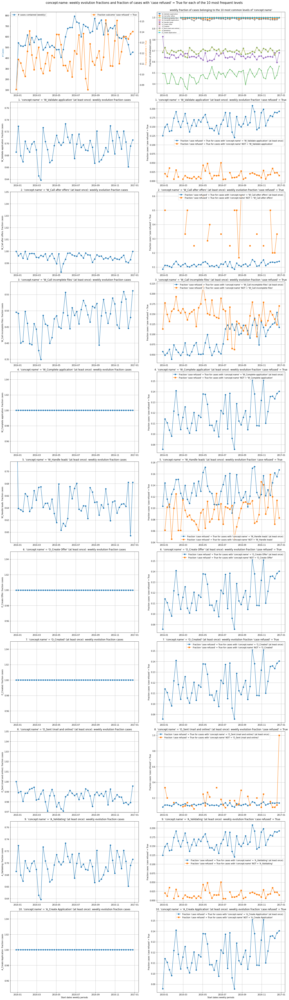

In [37]:
bpic17_plots.set_outcomeColumn(outcome = 'case refused')
bpic17_plots.topK_categorical_eventftr_evol(event_feature = 'concept:name', plt_type = 'type_outcome')

##### 4.2.3.C Outcome - __'case canceled'__

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'concept:name': 100%|██████████| 10/10 [00:00<00:00, 30.52it/s]
c:\Users\Brecht\OneDrive\Documenten\2022-2023 PhD y1\DyLoPro_CaseStudies\DyLoPro\plotting_utils.py:294: RuntimeWarning: All-NaN slice encountered
  return np.nanmax(agg_df_MinusFliers, axis=0)  # max_values: shape (num series, )


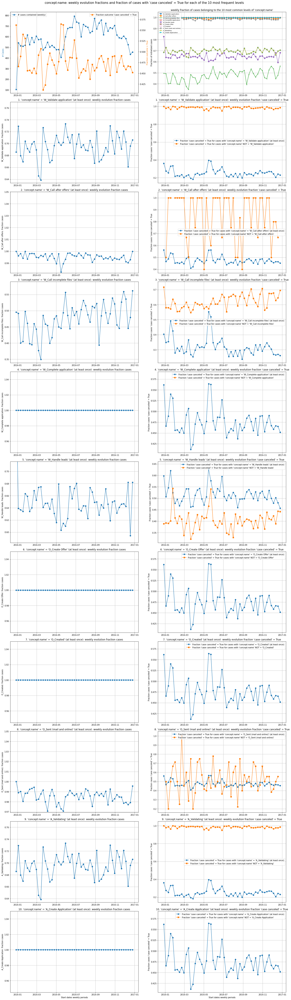

In [38]:
bpic17_plots.set_outcomeColumn(outcome = 'case canceled')
bpic17_plots.topK_categorical_eventftr_evol(event_feature = 'concept:name', plt_type = 'type_outcome')

## __5. Numerical Event Features__
__DyLoPro__ is primarily concerned with the visualization of case-level characteristics over time. However, numerical event features can take on different values for one and the same case. Therefore, to visualize case-level characteristics over time, an additional abstraction method is needed to project a trace's sequence of numerical event feature values to a single numeric value. This transformation can be specified by means of the `numEventFt_transform` parameter. DyLoPro provides the following `numEventFt_transform` options: 'last', 'first', 'mean', 'median', 'sum', 'prod', 'min' and 'max'. 

BPIC17 contains 5 numerical event features, namely `'FirstWithdrawalAmount'`, `'NumberOfTerms'`, `'MonthlyCost'`, `'CreditScore'` and `'OfferedAmount'`. Upon closer examination, all five event features only had non-null values for events pertaining to the Offer-related activity 'O_Create Offer'. This corresponds creation of an offer to a loan applicant, and accordingly, all five numerical event features contain information about the offered loan proposal. Multiple offers can be made for one and the same case (i.e. loan application) and hence all five numerical event features can take on different values for different events of the same case. After a first exploratory analysis of the 5 numeric event features, we observed the following: 
- `'NumberOfTerms'`, `'MonthlyCost'` and `'OfferedAmount'`: Greater than 0 for each non-null value / occurrence. 
- `'CreditScore'`: Each case has maximally 1 value greater than 0 (except for 3 cases), and more than 16,000 cases only have values equal to 0. If for a certain case a value greater than 0 occurs, then only the event pertaining to the offer that is selected *(`'Selected'=True`)* by the customer gets assigned a `'CreditScore'` value greater than 0. 
- `'FirstWithdrawalAmount'`: 7,895 cases only have values equal to 0. Other cases can have different distinct values, including 0 and positve values. 

For this reason, we chose the following abstraction methods: 
- `'NumberOfTerms'`, `'MonthlyCost'` and `'OfferedAmount'`: __'mean'__, each case is assigned the mean value over all its non-null values of the numerical event feature. 
- `'FirstWithdrawalAmount'` and `'CreditScore'`: __'max'__, each case is assigned the maximal value over all the non-null values that occurred during its execution. 


https://www.win.tue.nl/bpi/doku.php?id=2017:challenge

In [39]:
numeric_eventfeatures

['FirstWithdrawalAmount',
 'NumberOfTerms',
 'MonthlyCost',
 'CreditScore',
 'OfferedAmount']

### __5.1 Numerical Event Features: 'NumberOfTerms', 'MonthlyCost' and 'OfferedAmount'__

#### __5.1.1 'NumberOfTerms', 'MonthlyCost' and 'OfferedAmount'__ - Representation type: __Throughput Time (TT)__

In [40]:
subset_NumEvFtrs = ['NumberOfTerms', 'MonthlyCost', 'OfferedAmount']

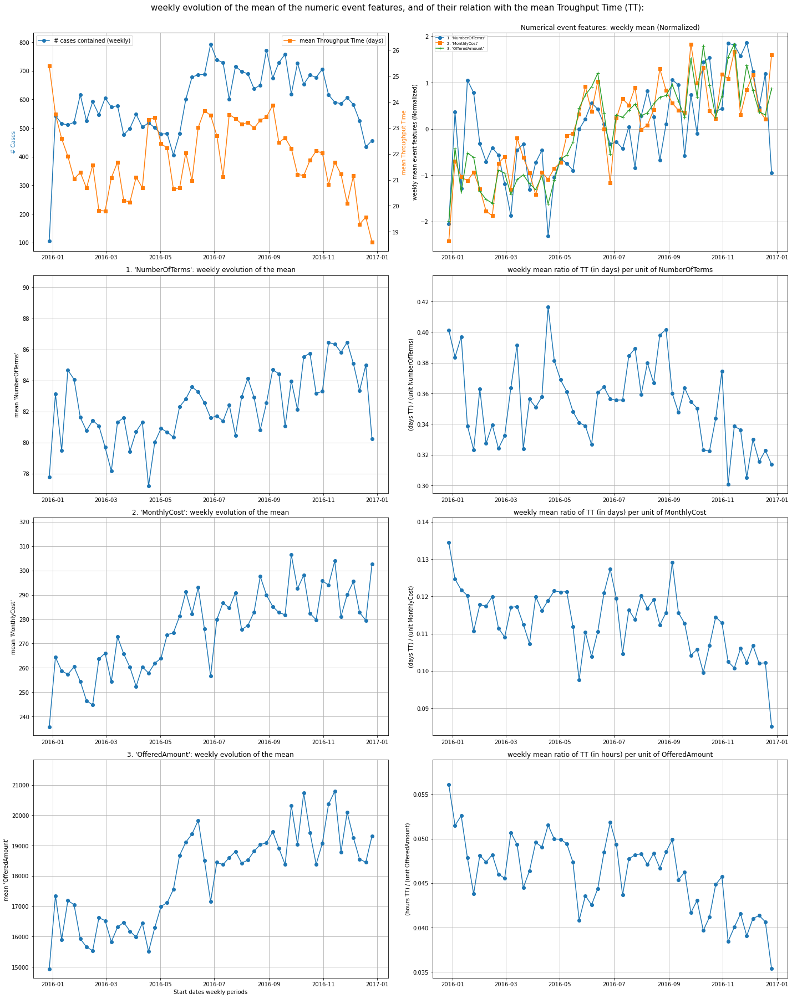

In [41]:
bpic17_plots.num_eventfts_evol(numeric_event_list = subset_NumEvFtrs, plt_type = 'type_tt', numEventFt_transform = 'mean')

#### __5.1.2 'NumberOfTerms', 'MonthlyCost' and 'OfferedAmount'__ - Representation type: __Case Length (NEPC)__

Computing the additional weekly NEPC aggregations for each of the 3 given numerical event features: 100%|██████████| 3/3 [00:00<00:00, 39.08it/s]


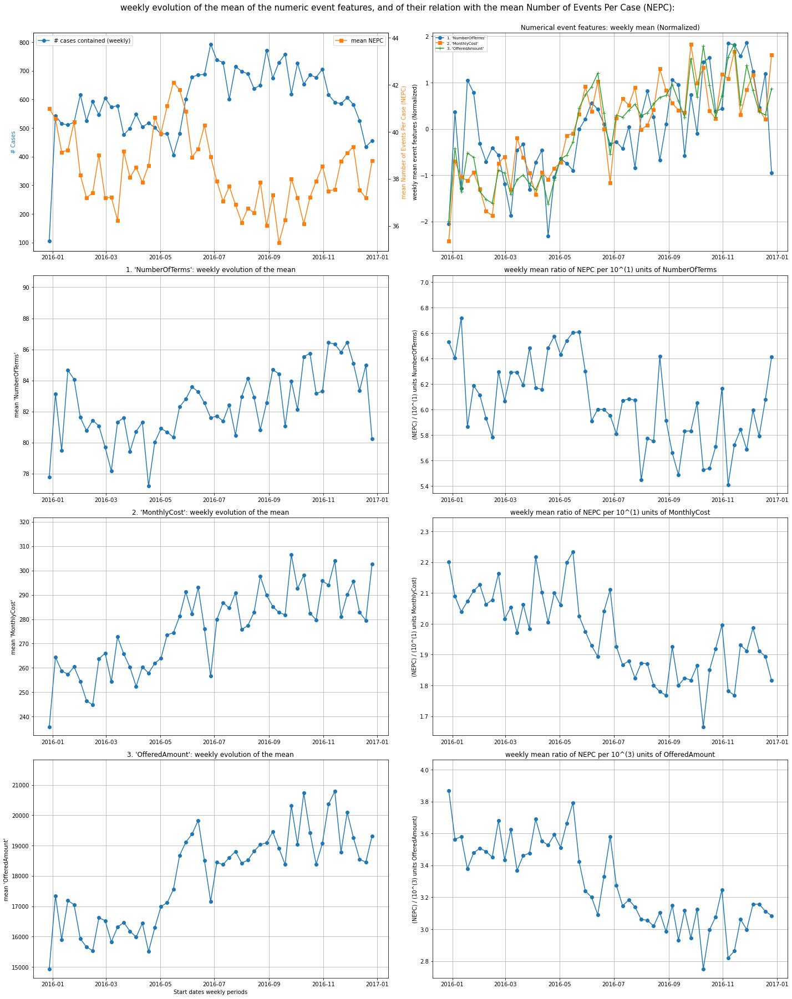

In [42]:
bpic17_plots.num_eventfts_evol(numeric_event_list = subset_NumEvFtrs, plt_type = 'type_events_case', numEventFt_transform = 'mean')

#### __5.1.3 'NumberOfTerms', 'MonthlyCost' and 'OfferedAmount'__ - Representation type: __Outcome__

##### 5.1.3.A Outcome - __'case accepted'__

Computing the additional weekly outcome aggregations for each of the 3 given numerical event features: 100%|██████████| 3/3 [00:00<00:00, 43.05it/s]


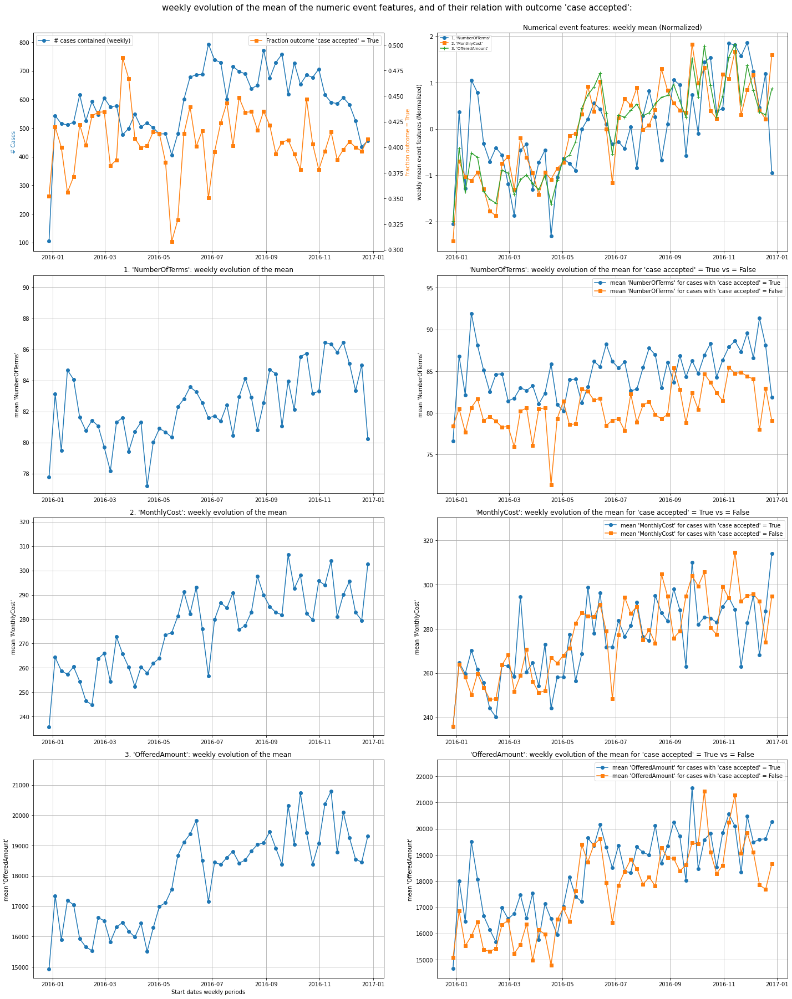

In [43]:
bpic17_plots.set_outcomeColumn(outcome = 'case accepted')
bpic17_plots.num_eventfts_evol(numeric_event_list = subset_NumEvFtrs, plt_type = 'type_outcome', numEventFt_transform = 'mean')

##### 5.1.3.B Outcome - __'case refused'__

Computing the additional weekly outcome aggregations for each of the 3 given numerical event features: 100%|██████████| 3/3 [00:00<00:00, 44.93it/s]


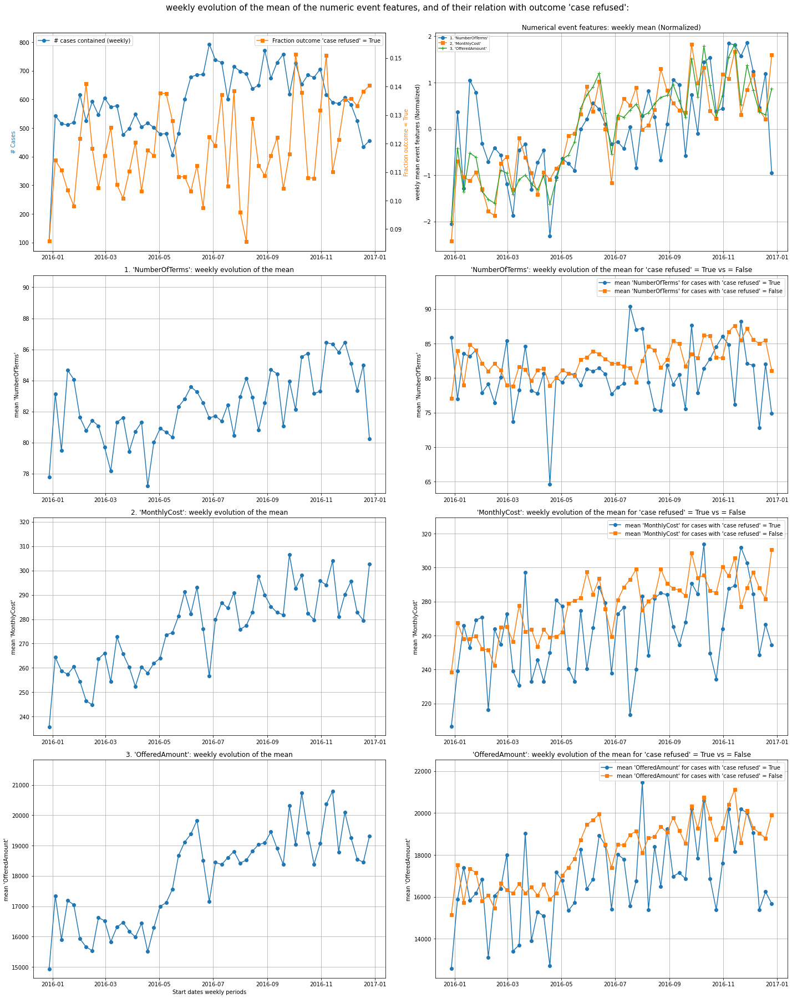

In [44]:
bpic17_plots.set_outcomeColumn(outcome = 'case refused')
bpic17_plots.num_eventfts_evol(numeric_event_list = subset_NumEvFtrs, plt_type = 'type_outcome', numEventFt_transform = 'mean')

##### 5.1.3.C Outcome - __'case canceled'__

Computing the additional weekly outcome aggregations for each of the 3 given numerical event features: 100%|██████████| 3/3 [00:00<00:00, 49.54it/s]


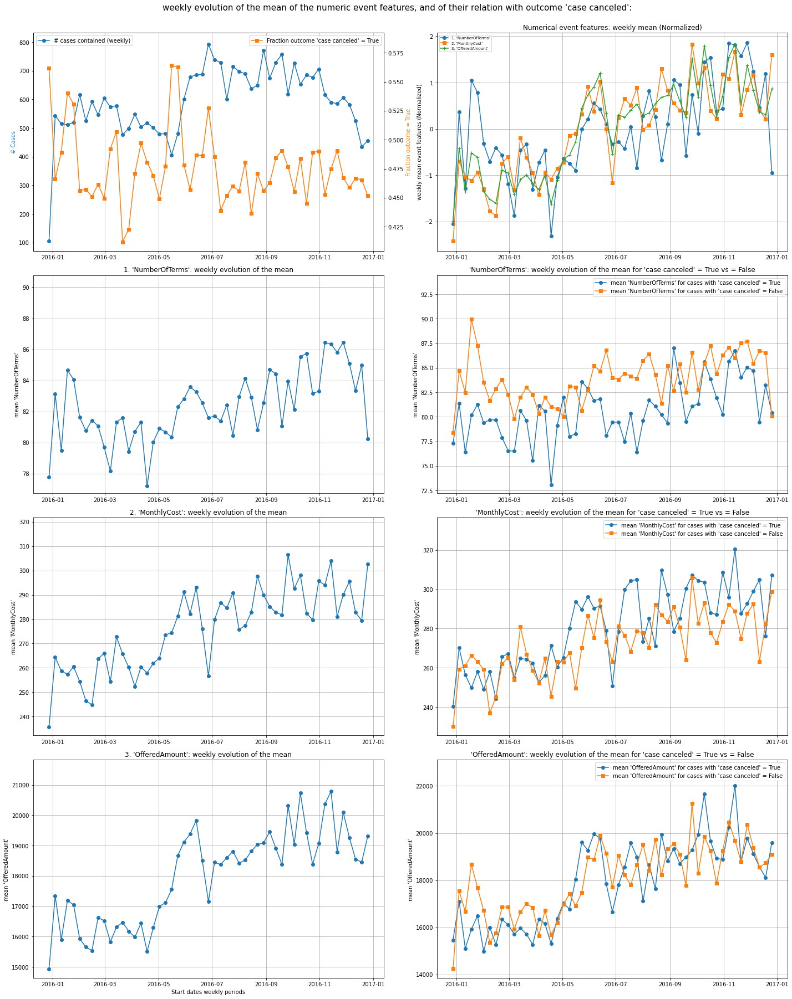

In [45]:
bpic17_plots.set_outcomeColumn(outcome = 'case canceled')
bpic17_plots.num_eventfts_evol(numeric_event_list = subset_NumEvFtrs, plt_type = 'type_outcome', numEventFt_transform = 'mean')

### __5.2 Numerical Event Features: 'FirstWithdrawalAmount' and 'CreditScore'__

#### __5.2.1 'FirstWithdrawalAmount' and 'CreditScore'__ - Representation type: __Throughput Time (TT)__

In [46]:
subset_NumEvFtrs = ['FirstWithdrawalAmount', 'CreditScore']

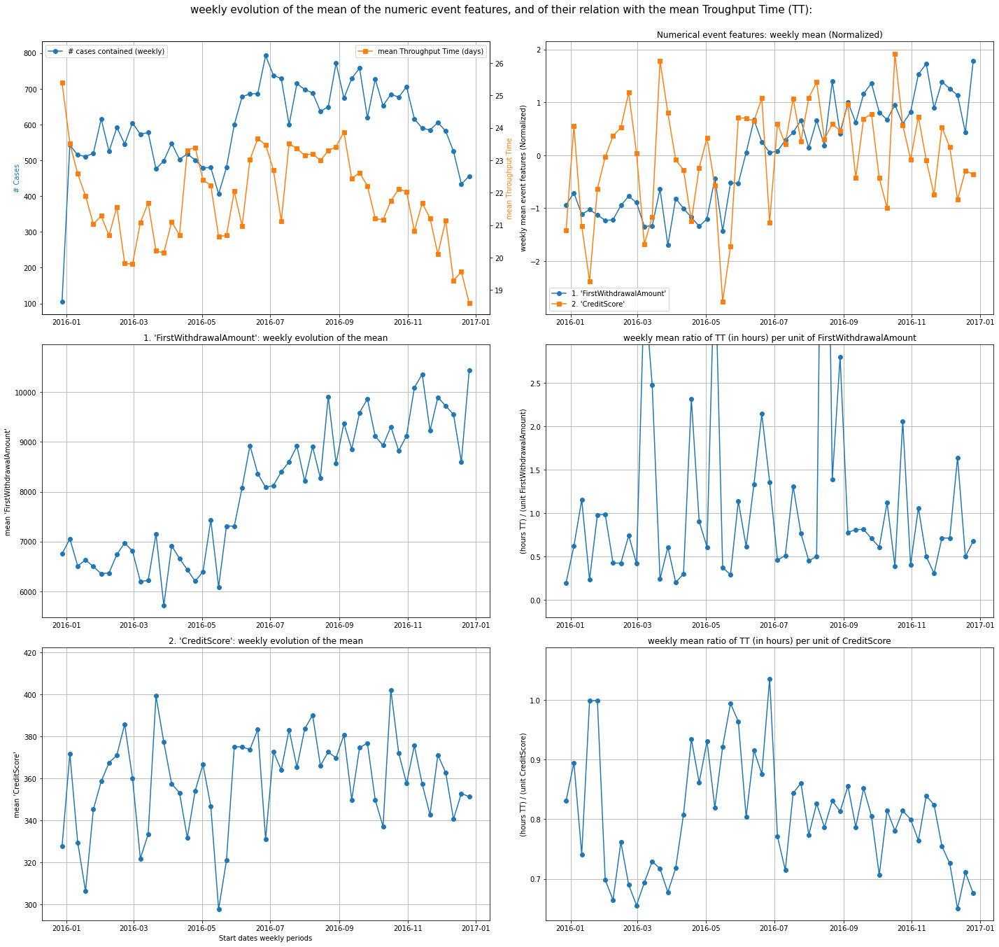

In [47]:
bpic17_plots.num_eventfts_evol(numeric_event_list = subset_NumEvFtrs, plt_type = 'type_tt', numEventFt_transform = 'mean')

#### __5.2.2 'FirstWithdrawalAmount' and 'CreditScore'__ - Representation type: __Case Length (NEPC)__

Computing the additional weekly NEPC aggregations for each of the 2 given numerical event features: 100%|██████████| 2/2 [00:00<00:00, 26.16it/s]


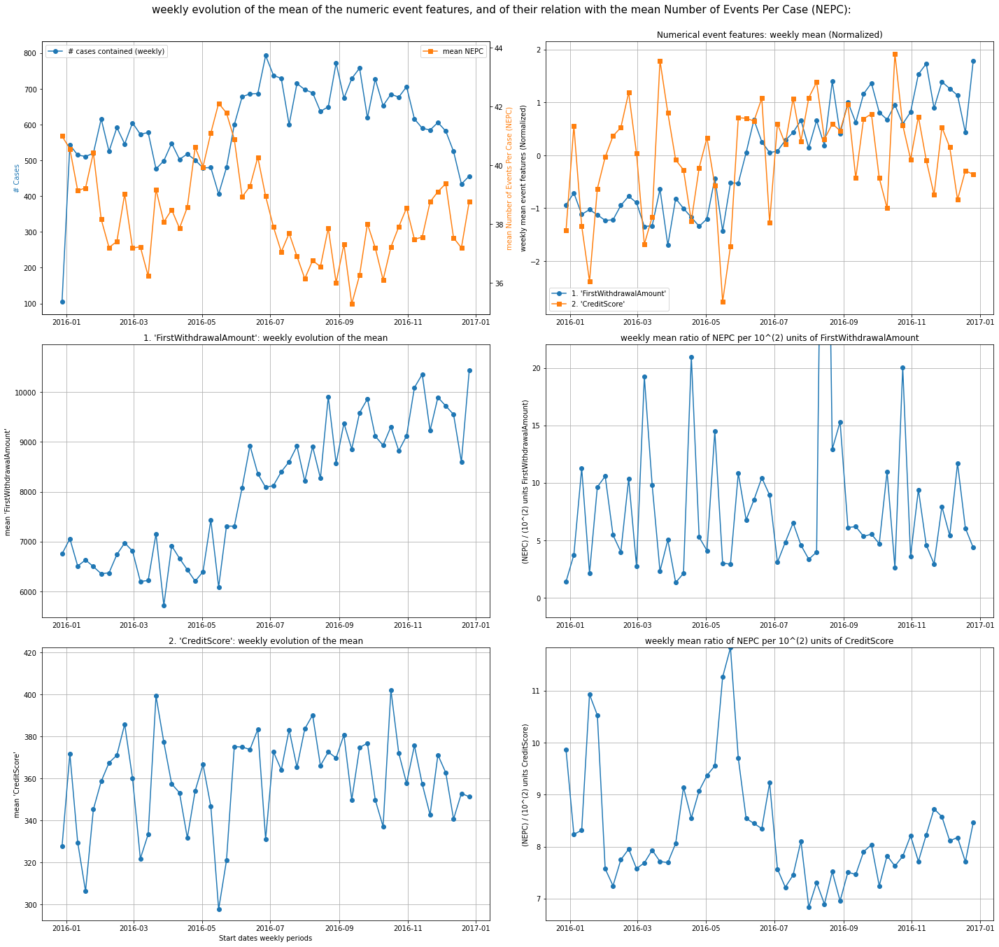

In [48]:
bpic17_plots.num_eventfts_evol(numeric_event_list = subset_NumEvFtrs, plt_type = 'type_events_case', numEventFt_transform = 'mean')

#### __5.2.3 'FirstWithdrawalAmount' and 'CreditScore'__ - Representation type: __Outcome__

##### 5.2.3.A Outcome - __'case accepted'__

Computing the additional weekly outcome aggregations for each of the 2 given numerical event features: 100%|██████████| 2/2 [00:00<00:00, 48.52it/s]


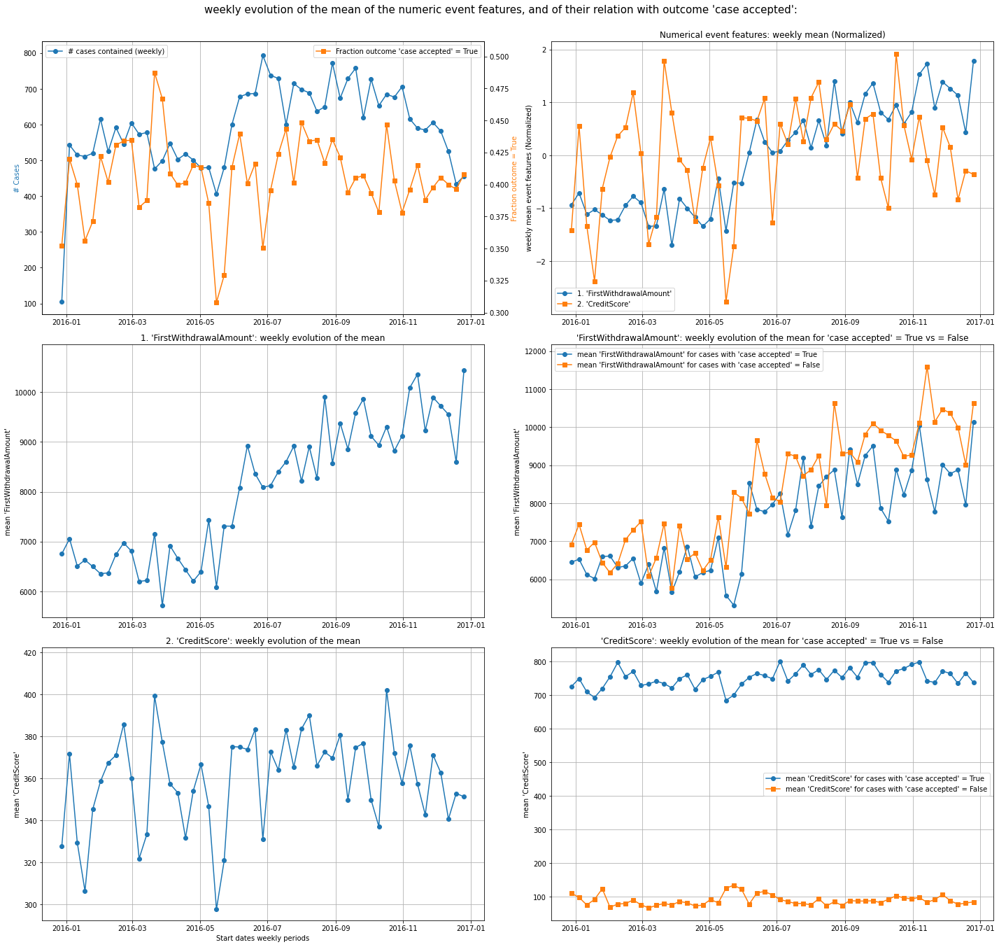

In [49]:
bpic17_plots.set_outcomeColumn(outcome = 'case accepted')
bpic17_plots.num_eventfts_evol(numeric_event_list = subset_NumEvFtrs, plt_type = 'type_outcome', numEventFt_transform = 'mean')

##### 5.2.3.B Outcome - __'case refused'__

Computing the additional weekly outcome aggregations for each of the 2 given numerical event features: 100%|██████████| 2/2 [00:00<00:00, 27.14it/s]


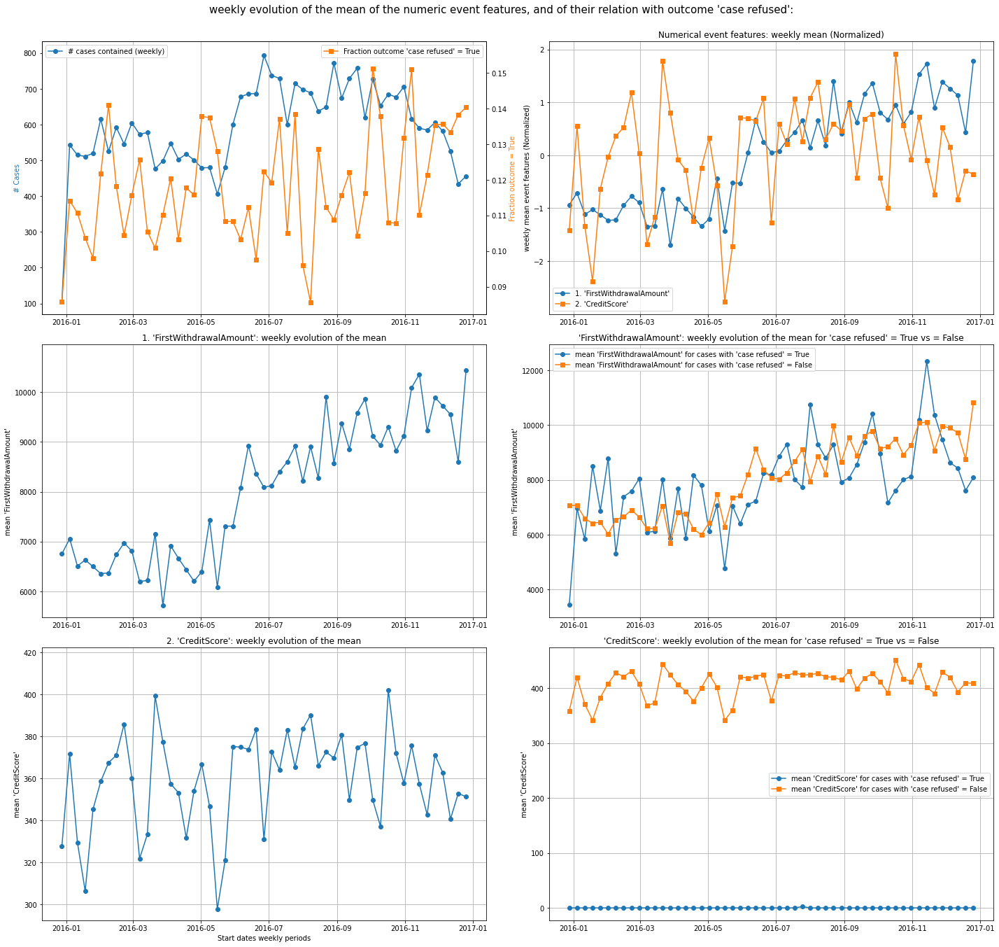

In [50]:
bpic17_plots.set_outcomeColumn(outcome = 'case refused')
bpic17_plots.num_eventfts_evol(numeric_event_list = subset_NumEvFtrs, plt_type = 'type_outcome', numEventFt_transform = 'mean')

##### 5.2.3.C Outcome - __'case canceled'__

Computing the additional weekly outcome aggregations for each of the 2 given numerical event features: 100%|██████████| 2/2 [00:00<00:00, 17.85it/s]


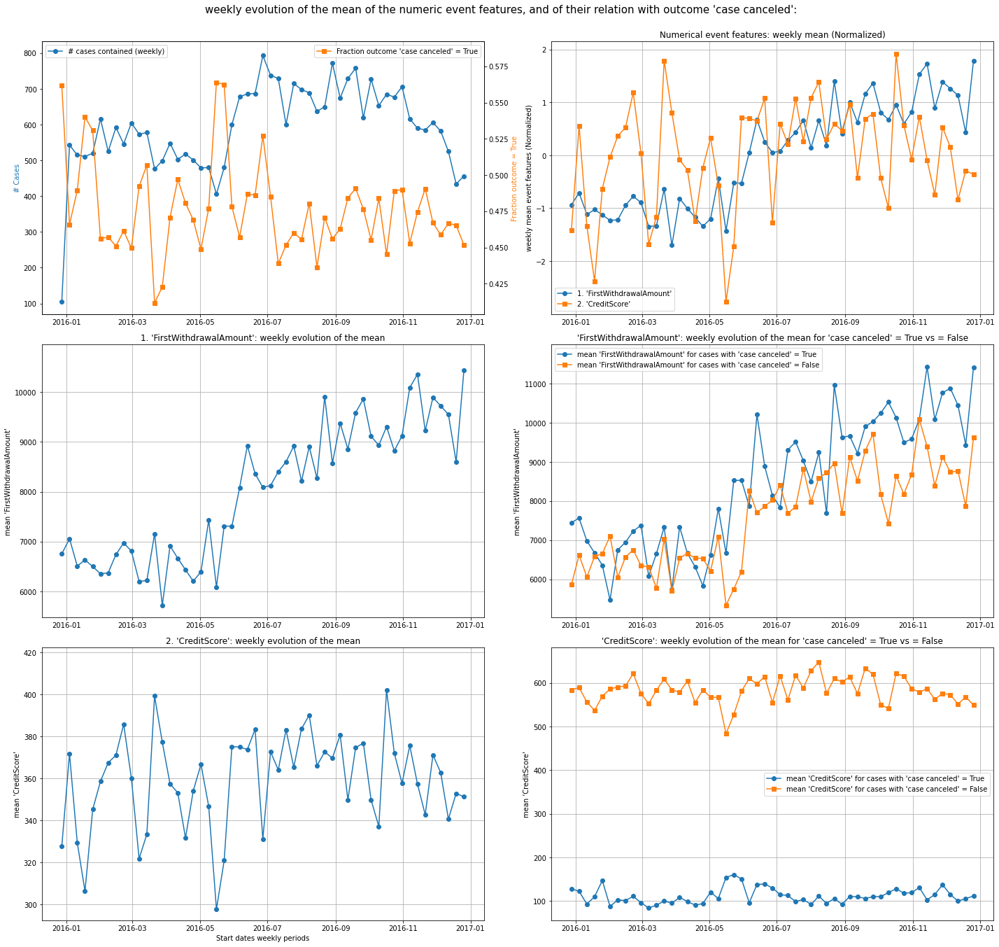

In [51]:
bpic17_plots.set_outcomeColumn(outcome = 'case canceled')
bpic17_plots.num_eventfts_evol(numeric_event_list = subset_NumEvFtrs, plt_type = 'type_outcome', numEventFt_transform = 'mean')